<a href="https://colab.research.google.com/github/oamerl/machine-learning-projects/blob/main/Machine-Learning/bank_customers_clustering_analysis/Bank_Customers_Clustering_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Importing needed libraries

import pandas as pd
import numpy as np

import plotly.express as px
import seaborn as sns
sns.set_context('talk')
sns.set_style('white')

import matplotlib.pyplot as plt
%matplotlib inline

import statsmodels.api as sm
import scipy
from scipy import stats
from scipy.stats import skew, norm
import scipy.stats as stats
#!pip install -q missingno
#import missingno as msno

!pip install -q yellowbrick

from sklearn.preprocessing import RobustScaler
from statsmodels.stats.power import TTestIndPower, TTestPower
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer


from datetime import datetime

#!pip install -q cliffs-delta
#from cliffs_delta import cliffs_delta

# the following code ensures that you can see your (print) results for multiple tasks within a coding block
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# change max_columns that defaults to 20 to be able to see all features statistics
pd.options.display.max_columns = 100
pd.options.display.width = None


# use the following to suppress scientific notation in Pandas
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# **Reading the Data and Indentifying its Structure and Properties**

In [ ]:
# Reading data

historical_transactions = pd.read_csv("/kaggle/input/cisc839-a1/data/historical_transactions.csv")
new_transactions = pd.read_csv("/kaggle/input/cisc839-a1/data/new_merchant_transactions.csv")
merchants = pd.read_csv("/kaggle/input/cisc839-a1/data/merchants.csv")
userscore = pd.read_csv("/kaggle/input/cisc839-a1/data/userscore.csv")

## General Information about Data and its Structure

In [ ]:
# Understanding data structure

historical_transactions.head(5)
new_transactions.head(5)
merchants.head(5)
userscore.head(5)

,authorized_flag,card_id,city_id,category_1,installments,category_3,merchant_category_id,merchant_id,month_lag,purchase_amount,purchase_date,category_2,state_id,subsector_id
0,Y,C_ID_4e6213e9bc,88,N,0,A,80,M_ID_e020e9b302,-8,-0.703331,2017-06-25 15:33:07,1.0,16,37
1,Y,C_ID_4e6213e9bc,88,N,0,A,367,M_ID_86ec983688,-7,-0.733128,2017-07-15 12:10:45,1.0,16,16
2,Y,C_ID_4e6213e9bc,88,N,0,A,80,M_ID_979ed661fc,-6,-0.720386,2017-08-09 22:04:29,1.0,16,37
3,Y,C_ID_4e6213e9bc,88,N,0,A,560,M_ID_e6d5ae8ea6,-5,-0.735352,2017-09-02 10:06:26,1.0,16,34
4,Y,C_ID_4e6213e9bc,88,N,0,A,80,M_ID_e020e9b302,-11,-0.722865,2017-03-10 01:14:19,1.0,16,37


,authorized_flag,card_id,city_id,category_1,installments,category_3,merchant_category_id,merchant_id,month_lag,purchase_amount,purchase_date,category_2,state_id,subsector_id
0,Y,C_ID_415bb3a509,107,N,1,B,307,M_ID_b0c793002c,1,-0.557574,2018-03-11 14:57:36,1.0,9,19
1,Y,C_ID_415bb3a509,140,N,1,B,307,M_ID_88920c89e8,1,-0.569580,2018-03-19 18:53:37,1.0,9,19
2,Y,C_ID_415bb3a509,330,N,1,B,507,M_ID_ad5237ef6b,2,-0.551037,2018-04-26 14:08:44,1.0,9,14
3,Y,C_ID_415bb3a509,-1,Y,1,B,661,M_ID_9e84cda3b1,1,-0.671925,2018-03-07 09:43:21,NaN,-1,8
4,Y,C_ID_ef55cf8d4b,-1,Y,1,B,166,M_ID_3c86fa3831,1,-0.659904,2018-03-22 21:07:53,NaN,-1,29


,merchant_id,merchant_group_id,merchant_category_id,subsector_id,numerical_1,numerical_2,category_1,most_recent_sales_range,most_recent_purchases_range,avg_sales_lag3,avg_purchases_lag3,active_months_lag3,avg_sales_lag6,avg_purchases_lag6,active_months_lag6,avg_sales_lag12,avg_purchases_lag12,active_months_lag12,category_4,city_id,state_id,category_2
0,M_ID_838061e48c,8353,792,9,-0.057471,-0.057471,N,E,E,-0.40,9.666667,3,-2.25,18.666667,6,-2.32,13.916667,12,N,242,9,1.0
1,M_ID_9339d880ad,3184,840,20,-0.057471,-0.057471,N,E,E,-0.72,1.750000,3,-0.74,1.291667,6,-0.57,1.687500,12,N,22,16,1.0
2,M_ID_e726bbae1e,447,690,1,-0.057471,-0.057471,N,E,E,-82.13,260.000000,2,-82.13,260.000000,2,-82.13,260.000000,2,N,-1,5,5.0
3,M_ID_a70e9c5f81,5026,792,9,-0.057471,-0.057471,Y,E,E,NaN,1.666667,3,NaN,4.666667,6,NaN,3.833333,12,Y,-1,-1,NaN
4,M_ID_64456c37ce,2228,222,21,-0.057471,-0.057471,Y,E,E,NaN,0.500000,3,NaN,0.361111,6,NaN,0.347222,12,Y,-1,-1,NaN


,card_id,first_active_month,feature_1,feature_2,feature_3,score
0,C_ID_92a2005557,Jun-17,5,2,1,-0.820283
1,C_ID_3d0044924f,Jan-17,4,1,0,0.392913
2,C_ID_d639edf6cd,Aug-16,2,2,0,0.688056
3,C_ID_186d6a6901,Sep-17,4,3,0,0.142495
4,C_ID_cdbd2c0db2,Nov-17,1,3,0,-0.159749


In [ ]:
# Printing some information about the data

historical_transactions.info()
print("\n")
new_transactions.info()
print("\n")
merchants.info()
print("\n")
userscore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29112361 entries, 0 to 29112360
Data columns (total 14 columns):
 #   Column                Dtype  
---  ------                -----  
 0   authorized_flag       object 
 1   card_id               object 
 2   city_id               int64  
 3   category_1            object 
 4   installments          int64  
 5   category_3            object 
 6   merchant_category_id  int64  
 7   merchant_id           object 
 8   month_lag             int64  
 9   purchase_amount       float64
 10  purchase_date         object 
 11  category_2            float64
 12  state_id              int64  
 13  subsector_id          int64  
dtypes: float64(2), int64(6), object(6)
memory usage: 3.0+ GB


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1963031 entries, 0 to 1963030
Data columns (total 14 columns):
 #   Column                Dtype  
---  ------                -----  
 0   authorized_flag       object 
 1   card_id               object 
 2   cit

In [ ]:
# Understanding data statistics

historical_transactions.describe(include = 'all')
new_transactions.describe(include = 'all')
merchants.describe(include = 'all')
userscore.describe(include = 'all')

,authorized_flag,card_id,city_id,category_1,installments,category_3,merchant_category_id,merchant_id,month_lag,purchase_amount,purchase_date,category_2,state_id,subsector_id
count,29112361,29112361,2.911236e+07,29112361,2.911236e+07,28934202,2.911236e+07,28973880,2.911236e+07,2.911236e+07,29112361,2.645950e+07,2.911236e+07,2.911236e+07
unique,2,325540,NaN,2,NaN,3,NaN,326311,NaN,NaN,16395300,NaN,NaN,NaN
top,Y,C_ID_3d3dfdc692,NaN,N,NaN,A,NaN,M_ID_00a6ca8a8a,NaN,NaN,2017-11-24 00:00:00,NaN,NaN,NaN
freq,26595452,5582,NaN,27028332,NaN,15411747,NaN,1115097,NaN,NaN,26184,NaN,NaN,NaN
mean,NaN,NaN,1.293256e+02,NaN,6.484954e-01,NaN,4.810130e+02,NaN,-4.487294e+00,3.640090e-02,NaN,2.194578e+00,1.056679e+01,2.684839e+01
std,NaN,NaN,1.042563e+02,NaN,2.795577e+00,NaN,2.493757e+02,NaN,3.588800e+00,1.123522e+03,NaN,1.531896e+00,6.366927e+00,9.692793e+00
min,NaN,NaN,-1.000000e+00,NaN,-1.000000e+00,NaN,-1.000000e+00,NaN,-1.300000e+01,-7.469078e-01,NaN,1.000000e+00,-1.000000e+00,-1.000000e+00
25%,NaN,NaN,5.300000e+01,NaN,0.000000e+00,NaN,3.070000e+02,NaN,-7.000000e+00,-7.203559e-01,NaN,1.000000e+00,9.000000e+00,1.900000e+01
50%,NaN,NaN,9.000000e+01,NaN,0.000000e+00,NaN,4.540000e+02,NaN,-4.000000e+00,-6.883495e-01,NaN,1.000000e+00,9.000000e+00,2.900000e+01
75%,NaN,NaN,2.120000e+02,NaN,1.000000e+00,NaN,7.050000e+02,NaN,-2.000000e+00,-6.032543e-01,NaN,3.000000e+00,1.600000e+01,3.400000e+01


,authorized_flag,card_id,city_id,category_1,installments,category_3,merchant_category_id,merchant_id,month_lag,purchase_amount,purchase_date,category_2,state_id,subsector_id
count,1963031,1963031,1.963031e+06,1963031,1.963031e+06,1907109,1.963031e+06,1936815,1.963031e+06,1.963031e+06,1963031,1.851286e+06,1.963031e+06,1.963031e+06
unique,1,290001,NaN,2,NaN,3,NaN,226129,NaN,NaN,1667025,NaN,NaN,NaN
top,Y,C_ID_b7ebee6539,NaN,N,NaN,A,NaN,M_ID_00a6ca8a8a,NaN,NaN,2017-11-18 00:00:00,NaN,NaN,NaN
freq,1963031,109,NaN,1899935,NaN,922244,NaN,23018,NaN,NaN,582,NaN,NaN,NaN
mean,NaN,NaN,1.343867e+02,NaN,6.829643e-01,NaN,4.309701e+02,NaN,1.476515e+00,-5.509690e-01,NaN,2.197841e+00,1.088067e+01,2.597624e+01
std,NaN,NaN,1.015152e+02,NaN,1.584069e+00,NaN,2.463385e+02,NaN,4.994483e-01,6.940043e-01,NaN,1.528125e+00,6.038542e+00,1.012908e+01
min,NaN,NaN,-1.000000e+00,NaN,-1.000000e+00,NaN,-1.000000e+00,NaN,1.000000e+00,-7.468928e-01,NaN,1.000000e+00,-1.000000e+00,-1.000000e+00
25%,NaN,NaN,6.900000e+01,NaN,0.000000e+00,NaN,2.780000e+02,NaN,1.000000e+00,-7.166294e-01,NaN,1.000000e+00,9.000000e+00,1.900000e+01
50%,NaN,NaN,1.100000e+02,NaN,1.000000e+00,NaN,3.670000e+02,NaN,1.000000e+00,-6.748406e-01,NaN,1.000000e+00,9.000000e+00,2.900000e+01
75%,NaN,NaN,2.120000e+02,NaN,1.000000e+00,NaN,6.830000e+02,NaN,2.000000e+00,-5.816162e-01,NaN,3.000000e+00,1.500000e+01,3.400000e+01


,merchant_id,merchant_group_id,merchant_category_id,subsector_id,numerical_1,numerical_2,category_1,most_recent_sales_range,most_recent_purchases_range,avg_sales_lag3,avg_purchases_lag3,active_months_lag3,avg_sales_lag6,avg_purchases_lag6,active_months_lag6,avg_sales_lag12,avg_purchases_lag12,active_months_lag12,category_4,city_id,state_id,category_2
count,334696,334696.000000,334696.000000,334696.000000,334696.000000,334696.000000,334696,334696,334696,334683.000000,3.346960e+05,334696.000000,3.346830e+05,3.346960e+05,334696.000000,3.346830e+05,3.346960e+05,334696.000000,334696,334696.000000,334696.000000,322809.000000
unique,334633,NaN,NaN,NaN,NaN,NaN,2,5,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN
top,M_ID_42697d5d44,NaN,NaN,NaN,NaN,NaN,N,E,E,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN
freq,4,NaN,NaN,NaN,NaN,NaN,327657,177104,175309,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,238596,NaN,NaN,NaN
mean,NaN,31028.736143,423.131663,25.116404,0.011476,0.008103,NaN,NaN,NaN,13.832993,inf,2.994108,2.165079e+01,inf,5.947397,2.522771e+01,inf,11.599335,NaN,102.917926,11.860942,2.380002
std,NaN,31623.043426,252.898046,9.807371,1.098154,1.070497,NaN,NaN,NaN,2395.489999,NaN,0.095247,3.947108e+03,NaN,0.394936,5.251842e+03,NaN,1.520138,NaN,107.090673,6.176889,1.562661
min,NaN,1.000000,-1.000000,-1.000000,-0.057471,-0.057471,NaN,NaN,NaN,-82.130000,3.334953e-01,1.000000,-8.213000e+01,1.670447e-01,1.000000,-8.213000e+01,9.832954e-02,1.000000,NaN,-1.000000,-1.000000,1.000000
25%,NaN,3612.000000,222.000000,19.000000,-0.057471,-0.057471,NaN,NaN,NaN,0.880000,9.236499e-01,3.000000,8.500000e-01,9.022475e-01,6.000000,8.500000e-01,8.983333e-01,12.000000,NaN,-1.000000,9.000000,1.000000
50%,NaN,19900.000000,373.000000,27.000000,-0.057471,-0.057471,NaN,NaN,NaN,1.000000,1.016667e+00,3.000000,1.010000e+00,1.026961e+00,6.000000,1.020000e+00,1.043361e+00,12.000000,NaN,69.000000,9.000000,2.000000
75%,NaN,51707.250000,683.000000,33.000000,-0.047556,-0.047556,NaN,NaN,NaN,1.160000,1.146522e+00,3.000000,1.230000e+00,1.215575e+00,6.000000,1.290000e+00,1.266480e+00,12.000000,NaN,182.000000,16.000000,4.000000


,card_id,first_active_month,feature_1,feature_2,feature_3,score
count,201917,201917,201917.000000,201917.000000,201917.000000,201917.000000
unique,201917,75,NaN,NaN,NaN,NaN
top,C_ID_92a2005557,Sep-17,NaN,NaN,NaN,NaN
freq,1,13878,NaN,NaN,NaN,NaN
mean,NaN,NaN,3.105311,1.745410,0.565569,-0.393636
std,NaN,NaN,1.186160,0.751362,0.495683,3.850500
min,NaN,NaN,1.000000,1.000000,0.000000,-33.219281
25%,NaN,NaN,2.000000,1.000000,0.000000,-0.883110
50%,NaN,NaN,3.000000,2.000000,1.000000,-0.023437
75%,NaN,NaN,4.000000,2.000000,1.000000,0.765453


During data cleaning and preparation we discoverd the following:
* **For missing values:**

    - The historical_transactions data contains a total of 2,969,504 missing values
        - category_2   :  2,652,864
        - category_3   :   178,159
        - merchant_id  :   138,481
    - The new_transactions data contains a total of 193,883 missing values
        - category_2   :  111,745
        - category_3   :   55,922
        - merchant_id  :   26,216
    - The merchants data contains a total of 11926 missing values
        - category_2    :     11,887
        - avg_sales_lag6 :       13
        - avg_sales_lag12 :      13
        - avg_sales_lag3  :      13
    - The userscore data contains a total of 0 missing values
    
    - From the missingo charts we noticed that there is no common pattern for missing values in "historical_transactions" & "new_transactions data", however The missing values can be MAR and be related to ceratin values of other features which can we be checked for or be MNAR and be related to some hidden latent variables that we don't observe in our dataset in both cases so it would be better if we use any multivariate imputation technique as KNN imputer or iterative imputer to avoid introducing any bias by imputing the missing values, however in sake of simplicity we will assume the missing values to be MCAR such that we can use simple imputation methods such as replacing by the mean for numerical features or by the most frequent for categorical features. We assume doing so will not have a severe impact as the missing values are in low numbers in comparison to the data volume and the highest percentage of missing values is under 10%, also we will later aggregate each user transactions together to have one record for each card_id so the imputation effect will be less.

    - For "merchant" data we can notice that the following three features are missed together avg_sales_lag6, avg_sales_lag12, avg_sales_lag3 for 13 merchants so we can impute them with the mode value which will represent most repeated lag also this wont have bad impact given their extremely low number.
    
    - Missing data pattern can be considered: "General Pattern" for "historical_transactions" & "new_transactions" data but "Unit Response Pattern" for "merhants" data
    
    
* **For duplicates entries checks:**

    - There are 0 duplicated identical rows in userscore data
    - There are 0 duplicated card_ids in userscore data
    - There are 0 duplicated identical transactions in histroical_transactions data
    - There are 0 duplicated identical transactions in new_transactions data
    - There are 0 duplicated identical rows in merchants data
    - There are 63 duplicated merchant ids with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency
    - There are 51 duplicated collective merchant ids enrties with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency
    - After we dropped duplicate collective merchant identifiers that have different features values we checked the duplicated merchant_ids and there were 12 duplicated merchant ids with inconsistent merchants data still remaining, by eyeballing we can notice that these merchant_ids can have 2 different merchant_group_id or merchant_category_id however most of them have the feature values the same, it was noticed later that there other inconsisent values in the features as well.
    - There are 12236 transactions done with the 12 noisy merchants in historical data
    - There are 1618 transactions done with the 12 noisy merchants in new transactions data
    - Due to these inconsistency we decided not to merge the merchnats data with other datasets
    
    
* **For outliers and inconsistet values checks:**

    - It was found that the number of unique card_ids in userscore is less than that in historical_transcation & new_transactions concatenated, this means that there are transactions for card_ids that we don't have info for in the userscore.csv file, these card_ids will be removed when we merge the datasets.
    - number of unique card_ids in userscore: 201917
    - number of unique card_ids in historical_transactions: 325540
    - number of unique card_ids in new_transactions: 290001
    - number of unique card_ids in historical_transactions and new_transactions combined: 325540
    - Checking the loyalty score histogram, clearly we saw that there are outliers
    - There are 2207 outlier cards having userscore<-30 in userscore data which will be excluded
    - When we checked values of 'installments' feature in historical and new transactions data which is number of installments of purchase, we found strange special values of -1 and 999, these numbers for sure are not representing the real supposed feature value so we should decide how to treat them either by dropping or by replacing.These special values may have meaning that we dont know or they can be just a placeholder for missing data. Since these transactions may have important information we will decide to replace these special values by the mean value of the installments instead of dropping them

# **Data Cleaning - Missing Values and Duplicates Checks**

## Missing Values Check

In [ ]:
# Checking missing values

# Count the total number of missing values for all features
print("The historical_transactions data contains a total of", historical_transactions.isnull().values.sum(), "missing values")
print("The new_transactions data contains a total of", new_transactions.isnull().values.sum(), "missing values")
print("The merchants data contains a total of", merchants.isnull().values.sum(), "missing values")
print("The userscore data contains a total of", userscore.isnull().values.sum(), "missing values")
print("\n")

# Column-wise summary of missing values count for each feature for each table
missing_historical_transactions = historical_transactions.isna().sum().sort_values(ascending = False)
missing_new_transactions = new_transactions.isna().sum().sort_values(ascending = False)
missing_merchants = merchants.isna().sum().sort_values(ascending = False)
missing_userscore = userscore.isna().sum().sort_values(ascending = False)

# filtering on features that have missing values
print("For historical_transactions there are", len(missing_historical_transactions[missing_historical_transactions>0]), "features that have missing values")
print("----------------------------------------")
missing_historical_transactions[missing_historical_transactions>0]
print("\n")

print("For new_transactions there are", len(missing_new_transactions[missing_new_transactions>0]), "features that have missing values")
print("----------------------------------------")
missing_new_transactions[missing_new_transactions>0]
print("\n")

print("For merchants there are", len(missing_merchants[missing_merchants>0]), "features that have missing values")
print("----------------------------------------")
missing_merchants[missing_merchants>0]
print("\n")

print("For userscore there are", len(missing_userscore[missing_userscore>0]), "features that have missing values")
print("----------------------------------------")
missing_userscore[missing_userscore>0]


The historical_transactions data contains a total of 2969504 missing values
The new_transactions data contains a total of 193883 missing values
The merchants data contains a total of 11926 missing values
The userscore data contains a total of 0 missing values


For historical_transactions there are 3 features that have missing values
----------------------------------------


category_2     2652864
category_3      178159
merchant_id     138481
dtype: int64



For new_transactions there are 3 features that have missing values
----------------------------------------


category_2     111745
category_3      55922
merchant_id     26216
dtype: int64



For merchants there are 4 features that have missing values
----------------------------------------


category_2         11887
avg_sales_lag6        13
avg_sales_lag12       13
avg_sales_lag3        13
dtype: int64



For userscore there are 0 features that have missing values
----------------------------------------


Series([], dtype: int64)

In [ ]:
# Visualize missing values using msno package
hist_tr_miss_col_names = missing_historical_transactions[missing_historical_transactions>0].index.values # features that do have missing values, columns names
new_tr_miss_col_names = missing_new_transactions[missing_new_transactions>0].index.values # features that do have missing values, columns names
merch_miss_col_names = missing_merchants[missing_merchants>0].index.values # features that do have missing values, columns names


* From the MSNO charts we noticed that there is no common pattern for missing values in "historical_transactions" & "new_transactions data",
* however The missing values can be MAR and be related to ceratin values of other features which can we be checked for or be MNAR and be related to some hidden latent variables that we don't observe in our dataset in both cases so it would be better if we use any multivariate imputation technique as KNN imputer or iterative imputer to avoid introducing any bias by imputing the missing values, however in sake of simplicity we will assume the missing values to be MCAR such that we can use simple imputation methods such as replacing by the mean for numerical features or by the most frequent for categorical features. We assume doing so will not have a severe impact as the missing values are in low numbers in comparison to the data volume and the highest percentage of missing values is under 10%, also we will later aggregate each user transactions together to have one record for each card_id so the imputation effect will be less.

* For "merchant" data we can notice that the following three features are missed together avg_sales_lag6, avg_sales_lag12, avg_sales_lag3 for 13 merchants so we can impute them with the mode value which will represent most repeated lag also this wont have bad impact given their extremely low number.

In [ ]:
# Changing the datatype of categorical features that have missing values to 'category' to be able to obtain most frequent value
for df in [historical_transactions,new_transactions]:
    df['category_2'] = df['category_2'].astype('category')
    df['category_3'] = df['category_3'].astype('category')
    df['merchant_id'] = df['merchant_id'].astype('category')


In [ ]:
# Printing most frequent values of categorical features that have missing values

print("\n Most repeated value of 'category_2' in historical_transactions is:",historical_transactions["category_2"].mode()[0]) # getting the most repeated category_2
print(historical_transactions["category_2"].value_counts()) # printing the values count of category_2

print("\n Most repeated value of 'category_3' in historical_transactions is:",historical_transactions["category_3"].mode()[0]) # getting the most repeated category_3
print(historical_transactions["category_3"].value_counts()) # printing the values count of category_3

print("\n Most repeated value of 'merchant_id' in historical_transactions is:",historical_transactions["merchant_id"].mode()[0]) # getting the most repeated merchant_id
print(historical_transactions["merchant_id"].value_counts()) # printing the values count of merchant_id

print("--------------------------------------------------------------------------------------")

print("\n Most repeated value of 'category_2' in new_transactions is:",new_transactions["category_2"].mode()[0]) # getting the most repeated category_2
print(new_transactions["category_2"].value_counts()) # printing the values count of category_2

print("\n Most repeated value of 'category_3' in new_transactions is:",new_transactions["category_3"].mode()[0]) # getting the most repeated category_3
print(new_transactions["category_3"].value_counts()) # printing the values count of category_3

print("\n Most repeated value of 'merchant_id' in new_transactions is:",new_transactions["merchant_id"].mode()[0]) # getting the most repeated merchant_id
print(new_transactions["merchant_id"].value_counts()) # printing the values count of merchant_id

print("--------------------------------------------------------------------------------------")

print("\n Most repeated value of 'category_2' in merchants is:",merchants["category_2"].mode()[0]) # getting the most repeated category_2
print(merchants["category_2"].value_counts()) # printing the values count of category_2


# Note:
# to get the most frequent value of categorical feature we can use either of below methods
# df["col"].value_counts().idxmax()
# or df["col"].mode()[0]


 Most repeated value of 'category_2' in historical_transactions is: 1.0
1.0    15177199
3.0     3911795
5.0     3725915
4.0     2618053
2.0     1026535
Name: category_2, dtype: int64

 Most repeated value of 'category_3' in historical_transactions is: A
A    15411747
B    11677522
C     1844933
Name: category_3, dtype: int64

 Most repeated value of 'merchant_id' in historical_transactions is: M_ID_00a6ca8a8a
M_ID_00a6ca8a8a    1115097
M_ID_e5374dabc0     428619
M_ID_9139332ccc     361385
M_ID_50f575c681     183894
M_ID_fc7d7969c3     177040
                    ...   
M_ID_4be25a7494          1
M_ID_ec5c44ccf3          1
M_ID_4be2f6c52d          1
M_ID_b55653ffc7          1
M_ID_896a73805d          1
Name: merchant_id, Length: 326311, dtype: int64
--------------------------------------------------------------------------------------

 Most repeated value of 'category_2' in new_transactions is: 1.0
1.0    1058242
3.0     289525
5.0     259266
4.0     178590
2.0      65663
Name: categor

From above analysis we obtained the most frequent values for the missing categorical features, we will use these values for imputation

* Most repeated value of 'category_2' in historical_transactions and new_transactions is: 1.0

* Most repeated value of 'category_3' in historical_transactions and new_transactions is: A

* Most repeated value of 'merchant_id' in historical_transactions and new_transactions is: M_ID_00a6ca8a8a

* Most repeated value of 'category_2' in merchants is: 1.0


In [ ]:
# Setting a dictionary of the coulmns containg nulls and the values to be added instead of the null (to be imputed by most frequent)
# it wont matter if we use historical_transactions or new_transactions to get most frequent value because as we have seen they have the same values.

values_to_fill_trns_NA = {"category_2": historical_transactions["category_2"].mode()[0], # 1.0
                     "category_3": historical_transactions["category_3"].mode()[0], # 'A'
                     "merchant_id": historical_transactions["merchant_id"].mode()[0]} # 'M_ID_00a6ca8a8a'

# Filling the null values in the transactions data by the predefined values
historical_transactions.fillna(value=values_to_fill_trns_NA, inplace=True)
new_transactions.fillna(value=values_to_fill_trns_NA, inplace=True)

# Merchant data missing values imputation
merchants['category_2'].fillna(merchants["category_2"].mode()[0], inplace=True) # it wont matter whcih dataset we get the most frequent category_2 value from as the three datasets have the same most repeated value as shown before
merchants['avg_sales_lag3'].fillna(merchants["avg_sales_lag3"].mode()[0], inplace=True) # most repeated lag value. we wont use mean value (~13.8) as it was much larger than the mode or median (~1)
merchants['avg_sales_lag6'].fillna(merchants["avg_sales_lag6"].mode()[0], inplace=True) # most repeated lag value. we wont use mean value (~21.7) as it was much larger than the mode or median (~1)
merchants['avg_sales_lag12'].fillna(merchants["avg_sales_lag12"].mode()[0], inplace=True) # most repeated lag value. we wont use mean value (~25.2) as it was much larger than the mode or median (~1)

# Count the total number of missing values for all features after imputation
print("After imputation, the historical_transactions data contains a total of", historical_transactions.isnull().values.sum(), "missing values")
print("After imputation, the new_transactions data contains a total of", new_transactions.isnull().values.sum(), "missing values")
print("After imputation, the merchants data contains a total of", merchants.isnull().values.sum(), "missing values")

/tmp/ipykernel_32/4201287123.py:9: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  historical_transactions.fillna(value=values_to_fill_trns_NA, inplace=True)
/tmp/ipykernel_32/4201287123.py:10: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  new_transactions.fillna(value=values_to_fill_trns_NA, inplace=True)


After imputation, the historical_transactions data contains a total of 0 missing values
After imputation, the new_transactions data contains a total of 0 missing values
After imputation, the merchants data contains a total of 0 missing values


## Duplicate Values Check

In [ ]:
# Userscore data duplicates check
userscore_dupl_rows = userscore.duplicated().sum() # checking for identical duplicate rows
userscore_dupl_card_id = userscore.duplicated(subset=['card_id']).sum() # checking for duplicate card_ids with different values which will represent inconsistency
# userscore.duplicated()[userscore.duplicated() == True]

print("There are {} duplicated identical rows in userscore data".format(userscore_dupl_rows))
print("There are {} duplicated card_ids in userscore data".format(userscore_dupl_card_id))

There are 0 duplicated identical rows in userscore data
There are 0 duplicated card_ids in userscore data


In [ ]:
# Transactions data duplicates check
hist_trns_dupl_rows = historical_transactions.duplicated().sum() # checking for identical duplicate rows
new_trns_dupl_rows = new_transactions.duplicated().sum() # checking for identical duplicate rows

# we wont check for duplicate rows on ids as its expected as each card_id with its related different ids will be repeated due to multiple different transactions

print("There are {} duplicated identical transactions in histroical_transactions data".format(hist_trns_dupl_rows))
print("There are {} duplicated identical transactions in new_transactions data".format(new_trns_dupl_rows))

There are 0 duplicated identical transactions in histroical_transactions data
There are 0 duplicated identical transactions in new_transactions data


In [ ]:
# Merchants data duplicates check
merchants_dupl_rows = merchants.duplicated().sum() # checking for identical duplicate rows
merchants_dupl_ids = merchants.duplicated(subset=['merchant_id']).sum() # checking for duplicate merchant_ids only which can take different attributes which will represent "inconsistency" in the entries
merchants_dupl_collective_ids = merchants.duplicated(subset=['merchant_id', 'merchant_group_id', 'merchant_category_id', 'subsector_id', 'city_id', 'state_id']).sum() # checking for duplicate ids with different values which will represent "inconsistency" in the entries

print("There are {} duplicated identical rows in merchants data".format(merchants_dupl_rows))
print("There are {} duplicated merchant ids with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency".format(merchants_dupl_ids))
print("There are {} duplicated collective merchant ids enrties with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency".format(merchants_dupl_collective_ids))

There are 0 duplicated identical rows in merchants data
There are 63 duplicated merchant ids with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency
There are 51 duplicated collective merchant ids enrties with different attributes in merchants data, these duplictes should be dropped to avoid inconsistency


In [ ]:
# Merchants duplicated rows dropping
merchants.drop_duplicates(subset=['merchant_id', 'merchant_group_id', 'merchant_category_id', 'subsector_id', 'city_id', 'state_id'], inplace=True) # dropping collective merchant ids duplicates
merchants.drop_duplicates(subset=['merchant_id'], inplace=True) # dropping remianing duplicates of merchant ids

# After we dropped duplicates will check if there are still any inconsistent data
print("There are {} duplicated identical rows in merchants data".format(merchants.duplicated().sum())) # checking for identical duplicate rows
print("There are {} duplicated merchant ids which can have different features values in merchants data".format(merchants.duplicated(subset=['merchant_id']).sum())) # checking for duplicate merchant_ids only
print("There are {} duplicated collective merchant ids enrties which can have different features values in merchants data".format(merchants.duplicated(subset=['merchant_id', 'merchant_group_id', 'merchant_category_id', 'subsector_id', 'city_id', 'state_id']).sum())) # checking for duplicate ids with different values

There are 0 duplicated identical rows in merchants data
There are 0 duplicated merchant ids which can have different features values in merchants data
There are 0 duplicated collective merchant ids enrties which can have different features values in merchants data


# **Data Preprocessing**

## "Userscore" Data Preprocessing

In [ ]:
# Data dictionary - features explaination of userscore.csv file
explain_userscore = pd.read_excel('/kaggle/input/cisc839-a1-data-dictionary/Data Dictionary.xlsx', sheet_name='userscore', header =2)
explain_userscore

,Columns,Description
0,card_id,Unique card identifier
1,first_active_month,"'YYYY-MM', month of first purchase"
2,feature_1,Anonymized card categorical feature
3,feature_2,Anonymized card categorical feature
4,feature_3,Anonymized card categorical feature
5,target,Loyalty numerical score calculated 2 months af...


In [ ]:
# Checking card_id counts consisitency

print("number of unique card_ids in userscore:", userscore["card_id"].nunique()) # 201,917 (cards that we have data and loyalty score for them)
print("number of unique card_ids in historical_transactions:", historical_transactions['card_id'].nunique()) # 325,540
print("number of unique card_ids in new_transactions:", new_transactions['card_id'].nunique()) # 290,001
print("number of unique card_ids in historical_transactions and new_transactions combined:",len(np.unique(np.concatenate((historical_transactions['card_id'], new_transactions['card_id']), axis =0)))) # 325,540

number of unique card_ids in userscore: 201917
number of unique card_ids in historical_transactions: 325540
number of unique card_ids in new_transactions: 290001
number of unique card_ids in historical_transactions and new_transactions combined: 325540


Since number of unique card_ids in userscore (201917) is less than that in historical_transcation & new_transactions (325540)

This means that there are transactions for card_ids that we don't have info for in the userscore.csv file, these card_ids will be removed automatically when we merge the datasets.

<Figure size 1200x800 with 0 Axes>

<Axes: ylabel='Count'>

Text(0.5, 1.0, 'Histogram of Loyalty Score')

Text(0.5, 0, 'Loyalty Score')

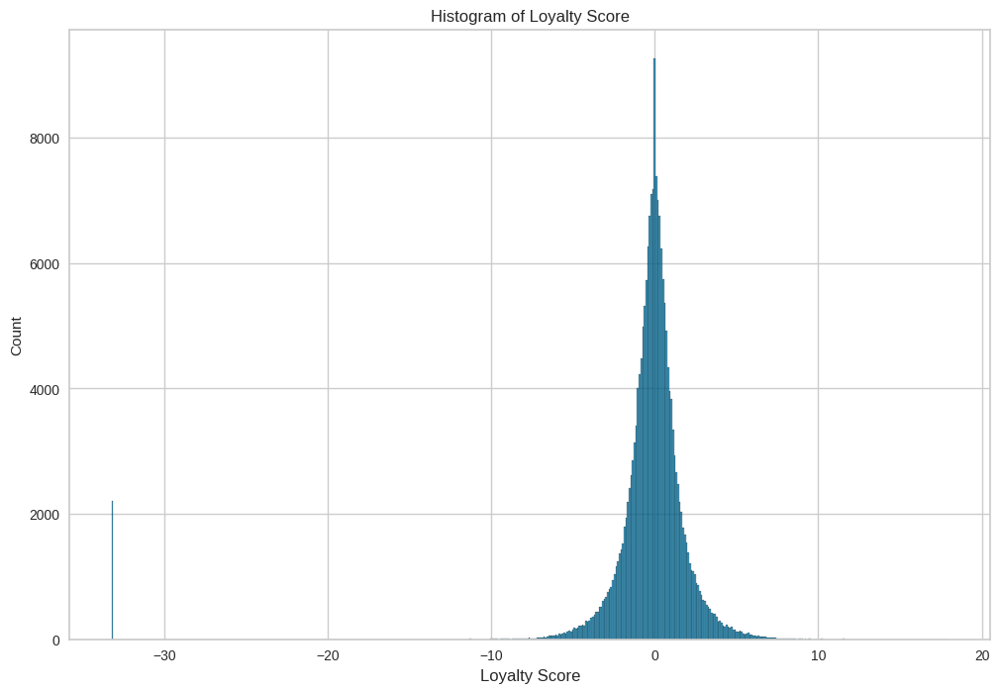

In [ ]:
# Checking the loyalty score histogram, clearly we will see that there are outliers

plt.figure(figsize=(12,8))
sns.histplot(userscore["score"].values, bins=500)
plt.title("Histogram of Loyalty Score")
plt.xlabel('Loyalty Score', fontsize=12)
plt.show()

In [ ]:
# Checking number of outliers
num_outliers = (userscore['score'] < -30).sum()
print("There are {} outlier cards in userscore data which will be excluded".format(num_outliers)) # 2207

# Dropping card_ids that have a score less than -30 which are representing outliers
# We will drop these outliers as the impact regression models severly
score_outliers_index = userscore[userscore['score'] < -30].index # indcies of oultliers entries in userscore df
userscore.drop(score_outliers_index, inplace=True) # dropping the outliers

# We can make a new feature to say whether this card_id is outlier or not and make another model using theses outliers but for now they are dropped
#userscore['outliers'] = 0
#userscore.loc[userscore['score'] < -30, 'outliers'] = 1
#userscore['outliers'].value_counts()

There are 2207 outlier cards in userscore data which will be excluded


<Figure size 1200x800 with 0 Axes>

<Axes: ylabel='Count'>

Text(0.5, 1.0, 'Histogram of Loyalty Score')

Text(0.5, 0, 'Loyalty Score')

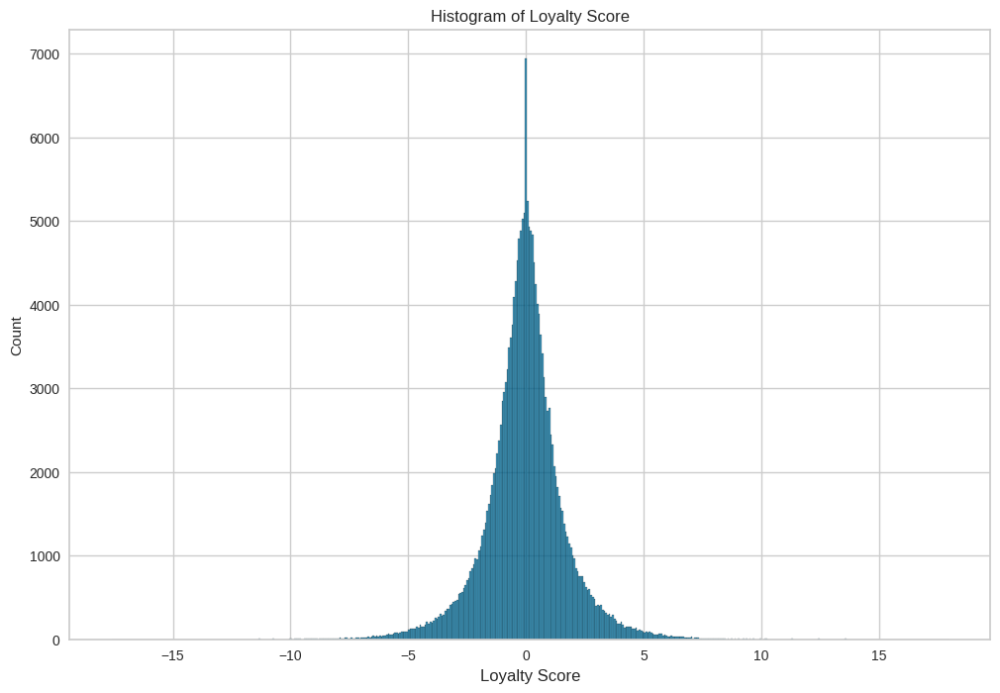

In [ ]:
# Re-checking the loyalty score histogram after outliers drop

plt.figure(figsize=(12,8))
sns.histplot(userscore["score"].values, bins=500)
plt.title("Histogram of Loyalty Score")
plt.xlabel('Loyalty Score', fontsize=12)
plt.show()

In [ ]:
# As mentioned in data dictionary features 1,2,3 are anonymized categorical features so will convert them to categorical

userscore['feature_1'] = userscore['feature_1'].astype('category')
userscore['feature_2'] = userscore['feature_2'].astype('category')
userscore['feature_3'] = userscore['feature_3'].astype('category')

* In order to make use of the "first_active_month" feature we need to first convert it to a datetime format that can be understood by pandas to avoid OutOfBoundsDatetime error
* After conversion, this absolute date value is useless on its own, however we can create new feature which can represent for how many days this card_id has been issued
* To calculate this card_id age value we need a reference date to subtract the issuing data from (first_active_month)
* We chose this refrence date to be the last (most recent) issuing data in userscore data, such that the last issued card will have an age of 0 days


In [ ]:
def date_formatting(string_date):
    """Given string datatime format of %b-%y eg. Jun-17 will convert it to %Y-%m format i.e 2017-06 to be able to use it later using pandas """
    return datetime.strftime(datetime.strptime(string_date,'%b-%y'),'%Y-%m')


userscore['first_active_month'] = userscore['first_active_month'].apply(lambda str_date: date_formatting(str_date)) # axis = 1 or 'columns': apply function to each row.
userscore['first_active_month'] = pd.to_datetime(userscore['first_active_month']) # converting first_active_date to datetime

userscore.head()

# Feature Creation
last_card_issuing_date = max(userscore['first_active_month'].dt.date) # maximum date
first_card_issuing_date = min(userscore['first_active_month'].dt.date) # minimum date

print("\n")
print(" Last card issuing date is:",last_card_issuing_date)
print(" First card issuing date is:",first_card_issuing_date)
print("\n")

def card_rel_age_days(timedelta_obj):
    """ returns the number of days from timedelta object"""
    return timedelta_obj.days

userscore['card_relative_age'] = last_card_issuing_date - userscore['first_active_month'].dt.date
userscore['card_relative_age'] = userscore['card_relative_age'].apply(lambda timedelta_obj: card_rel_age_days(timedelta_obj)) # card_id age in days

# Drop the "first_active_month" as we extracted its information in the new created feature "card_relative_age"
userscore = userscore.drop('first_active_month', axis=1)
userscore.head()

,card_id,first_active_month,feature_1,feature_2,feature_3,score
0,C_ID_92a2005557,2017-06-01,5,2,1,-0.820
1,C_ID_3d0044924f,2017-01-01,4,1,0,0.393
2,C_ID_d639edf6cd,2016-08-01,2,2,0,0.688
3,C_ID_186d6a6901,2017-09-01,4,3,0,0.142
4,C_ID_cdbd2c0db2,2017-11-01,1,3,0,-0.160




 Last card issuing date is: 2018-02-01
 First card issuing date is: 2011-11-01




,card_id,feature_1,feature_2,feature_3,score,card_relative_age
0,C_ID_92a2005557,5,2,1,-0.820,245
1,C_ID_3d0044924f,4,1,0,0.393,396
2,C_ID_d639edf6cd,2,2,0,0.688,549
3,C_ID_186d6a6901,4,3,0,0.142,153
4,C_ID_cdbd2c0db2,1,3,0,-0.160,92


## "merchants" Data Preprocessing

In [ ]:
# Data dictionary - features explaination of merchant data file
explain_merchants = pd.read_excel('/kaggle/input/cisc839-a1-data-dictionary/Data Dictionary.xlsx', sheet_name='merchant', header =2)
explain_merchants

,Columns,Description
0,merchant_id,Unique merchant identifier
1,merchant_group_id,Merchant group (anonymized )
2,merchant_category_id,Unique identifier for merchant category (anony...
3,subsector_id,Merchant category group (anonymized )
4,numerical_1,anonymized measure
5,numerical_2,anonymized measure
6,category_1,anonymized category
7,most_recent_sales_range,Range of revenue (monetary units) in last acti...
8,most_recent_purchases_range,Range of quantity of transactions in last acti...
9,avg_sales_lag3,Monthly average of revenue in last 3 months di...


In [ ]:
# Rechecking merchnat datatypes for proper conversions
merchants.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334633 entries, 0 to 334695
Data columns (total 22 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   merchant_id                  334633 non-null  object 
 1   merchant_group_id            334633 non-null  int64  
 2   merchant_category_id         334633 non-null  int64  
 3   subsector_id                 334633 non-null  int64  
 4   numerical_1                  334633 non-null  float64
 5   numerical_2                  334633 non-null  float64
 6   category_1                   334633 non-null  object 
 7   most_recent_sales_range      334633 non-null  object 
 8   most_recent_purchases_range  334633 non-null  object 
 9   avg_sales_lag3               334633 non-null  float64
 10  avg_purchases_lag3           334633 non-null  float64
 11  active_months_lag3           334633 non-null  int64  
 12  avg_sales_lag6               334633 non-null  float64
 13 

In [ ]:
# Adjust data types of feature in "historical" and "new" transactions
merchants['merchant_id'] = merchants['merchant_id'].astype('category')
merchants['merchant_group_id'] = merchants['merchant_group_id'].astype('category')
merchants['merchant_category_id'] = merchants['merchant_category_id'].astype('category')
merchants['subsector_id'] = merchants['subsector_id'].astype('category')
merchants['category_1'] = merchants['category_1'].map({'Y':1, 'N':0})
merchants['most_recent_sales_range'] = merchants['most_recent_sales_range'].astype('category')
merchants['most_recent_purchases_range'] = merchants['most_recent_purchases_range'].astype('category')
merchants['category_4'] = merchants['category_4'].map({'Y':1, 'N':0})
merchants['city_id'] = merchants['city_id'].astype('category')
merchants['state_id'] = merchants['state_id'].astype('category')
merchants['category_2'] = merchants['category_2'].astype('category')

## "Historical" and "New" Transactions Data Preprocessing

In [ ]:
# data dictionary - features explaination of historical and new transactions data files
explain_historical = pd.read_excel('/kaggle/input/cisc839-a1-data-dictionary/Data Dictionary.xlsx', sheet_name='history', header =2)
explain_historical

,Columns,Description
0,card_id,Card identifier
1,month_lag,month lag to reference date
2,purchase_date,Purchase date
3,authorized_flag,"Y' if approved, 'N' if denied"
4,category_3,anonymized category
5,installments,number of installments of purchase
6,category_1,anonymized category
7,merchant_category_id,Merchant category identifier (anonymized )
8,subsector_id,Merchant category group identifier (anonymized )
9,merchant_id,Merchant identifier (anonymized)


In [ ]:
# Rechecking datatypes for proper conversions
historical_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29112361 entries, 0 to 29112360
Data columns (total 14 columns):
 #   Column                Dtype   
---  ------                -----   
 0   authorized_flag       object  
 1   card_id               object  
 2   city_id               int64   
 3   category_1            object  
 4   installments          int64   
 5   category_3            category
 6   merchant_category_id  int64   
 7   merchant_id           category
 8   month_lag             int64   
 9   purchase_amount       float64 
 10  purchase_date         object  
 11  category_2            category
 12  state_id              int64   
 13  subsector_id          int64   
dtypes: category(3), float64(1), int64(6), object(4)
memory usage: 2.6+ GB


In [ ]:
# Adjust data types of feature in "historical" and "new" transactions
for df in [historical_transactions,new_transactions]:
    df['authorized_flag'] = df['authorized_flag'].map({'Y':1, 'N':0})
    df['city_id'] = df['city_id'].astype('category')
    df['category_1'] = df['category_1'].map({'Y':1, 'N':0})
    df['merchant_category_id'] = df['merchant_category_id'].astype('category')
    df['purchase_date'] = pd.to_datetime(df['purchase_date'])
    df['state_id'] = df['state_id'].astype('category')
    df['subsector_id'] = df['subsector_id'].astype('category')

### Some chosen features values analysis

#### "installments" Feature analysis

* When we checked values of 'installments' feature which is number of installments of purchase, we found strange special values of -1 and 999
* These numbers for sure are not representing the real supposed feature value so we should decide how to treat them either by dropping or by replacing.
* These special values may have meaning that we dont know or they can be just a placeholder for missing data
* Since these transactions may have important information we will decide to replace these special values by the mean value of the installments instead of dropping them

In [ ]:
historical_transactions['installments'].value_counts() # special values -1,999
new_transactions['installments'].value_counts() # special values -1,999

 0      15411747
 1      11677522
 2        666416
 3        538207
 4        179525
-1        178159
 6        132634
 10       118827
 5        116090
 12        55064
 8         20474
 7         10906
 9          5772
 11          830
 999         188
Name: installments, dtype: int64

 0      922244
 1      836178
-1       55922
 2       54729
 3       44750
 4       14815
 6       10389
 5        9296
 10       8899
 12       2850
 8        1555
 7         863
 9         478
 11         61
 999         2
Name: installments, dtype: int64

* We will replace the special values of -1 and 999 in historical and new transactions by the mean value
* We will calculate the mean of the installments feature in each dataset independently
* In order to calculate this mean value we will have first to remove these special values from the data


In [ ]:
special_hist_installments_index = historical_transactions[(historical_transactions.installments == -1) | (historical_transactions.installments == 999)].index # indcies of installments values of -1 or 999 in historical transactions
special_new_installments_index = new_transactions[(new_transactions.installments == -1) | (new_transactions.installments == 999)].index # indcies of installments values of -1 or 999 in new transactions

hist_trns_wo_special = historical_transactions.drop(special_hist_installments_index) # historical transactions without the special values of the installment feature
new_trns_wo_special = new_transactions.drop(special_new_installments_index) # new transactions without the special values of the installment feature

mean_installments_hist_trns = hist_trns_wo_special['installments'].mean() # mean value of installments in case of historical transactions
mean_installments_new_trns = new_trns_wo_special['installments'].mean() # mean value of installments in case of new transactions

print("Mean value of installments in case of historical transactions is {}, to be used to replace special values of -1 and 999".format(mean_installments_hist_trns))
print("Mean value of installments in case of new transactions is {}, to be used to replace special values of -1 and 999".format(mean_installments_new_trns))

# replacing -1 and 999 of "installments" feature in historical and new transactions by their corresponding mean value
historical_transactions['installments'] = historical_transactions['installments'].replace([-1,999], mean_installments_hist_trns)
new_transactions['installments'] = new_transactions['installments'].replace([-1,999], mean_installments_new_trns)

Mean value of installments in case of historical transactions is 0.6521590471339372, to be used to replace special values of -1 and 999
Mean value of installments in case of new transactions is 0.7312667826189092, to be used to replace special values of -1 and 999


#### "authorized_flag" Feature analysis

<Axes: title={'center': 'historical transactions authorized_flag value counts'}>

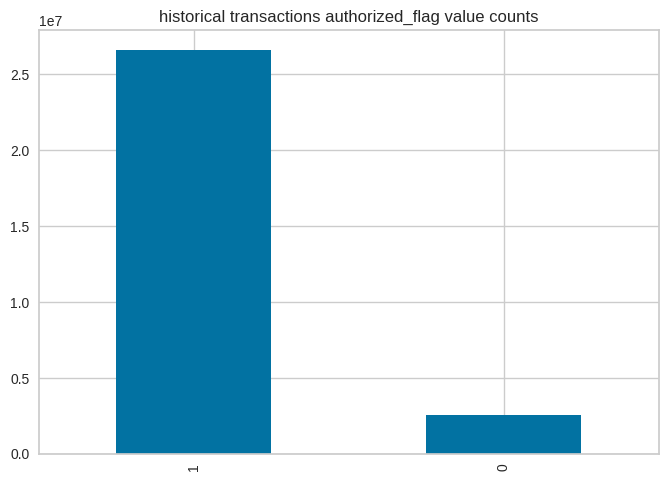

In [ ]:
# In historical_transactions we can see that we have authorized and unauthorized transactions
historical_transactions['authorized_flag'].value_counts().plot(kind='bar', title='historical transactions authorized_flag value counts', )

<Axes: title={'center': 'new transactions authorized_flag value counts'}>

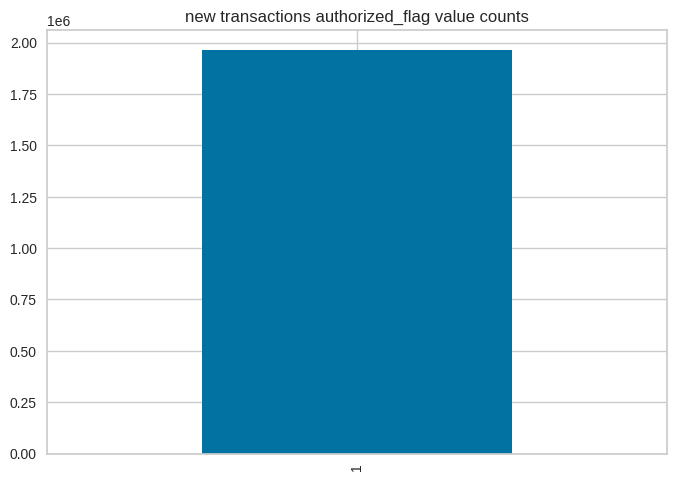

In [ ]:
# In new_transactions we only have authorized transactions
new_transactions['authorized_flag'].value_counts().plot(kind='bar', title='new transactions authorized_flag value counts')

### Merging "Merchants Data" with the "Transactions Data" before perfroming aggregations

We tried to merge the merchants data and the transactions data in 3 different ways with using differnet merchant identifiers.

**Case 1**: using the 'merchant_id' only

**Case 2**: using 'merchant_id', 'merchant_category_id', 'city_id', 'subsector_id' , 'state_id'

**Case 3**: using 'merchant_id', 'merchant_category_id', 'subsector_id'


**Case 1**

Merging transactions data and merchants data using the 'merchant_id' only

In [ ]:
merchants.columns = [('merch_' + feature if feature != 'merchant_id' else feature) for feature in merchants.columns] # adding a prefix for merchnats features names
merchants.info() # to check columns names

historical_transactions_merch = pd.merge(historical_transactions, merchants, on='merchant_id', how='left')
new_transactions_merch =  pd.merge(new_transactions, merchants, on='merchant_id', how='left')

print("\n")
print("Number of N/As in histroical transactions after merging with the merchants data using 'merchant_id' only is:", historical_transactions_merch.isnull().values.sum())
print("Number of N/As in new transactions after merging with the merchants data using 'merchant_id'only is:", new_transactions_merch.isnull().values.sum())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334633 entries, 0 to 334695
Data columns (total 22 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   merchant_id                        334633 non-null  category
 1   merch_merchant_group_id            334633 non-null  category
 2   merch_merchant_category_id         334633 non-null  category
 3   merch_subsector_id                 334633 non-null  category
 4   merch_numerical_1                  334633 non-null  float64 
 5   merch_numerical_2                  334633 non-null  float64 
 6   merch_category_1                   334633 non-null  object  
 7   merch_most_recent_sales_range      334633 non-null  category
 8   merch_most_recent_purchases_range  334633 non-null  category
 9   merch_avg_sales_lag3               334633 non-null  float64 
 10  merch_avg_purchases_lag3           334633 non-null  float64 
 11  merch_active_months_lag3  

**Case 2**

Merging transactions data and merchants data using the following ids ['merchant_id','merchant_category_id','city_id', 'subsector_id' , 'state_id']

In [ ]:
merchants.columns = [(feature.replace('merch_', '') if feature != 'merchant_id' else feature) for feature in merchants.columns] # removing the prefix for merchnats features names
merchants.info() # to check columns names

merging_ids = ['merchant_id','merchant_category_id','city_id', 'subsector_id' , 'state_id'] # ids both in merchants data and transaction data
merchants.columns = [('merch_' + feature if feature not in merging_ids else feature) for feature in merchants.columns] # adding a prefix for merchnats features names
merchants.info() # to check columns names

historical_transactions_merch_all_ids = pd.merge(historical_transactions, merchants, on=merging_ids, how='left')
new_transactions_merch_all_ids =  pd.merge(new_transactions, merchants, on=merging_ids, how='left')

print("\n")
print("Number of N/As in histroical transactions after merging with the merchants data using all merchant's identifiers is:",historical_transactions_merch_all_ids.isnull().values.sum())
print("Number of N/As in new transactions after merging with the merchants data using all merchant's identifiers is:",new_transactions_merch_all_ids.isnull().values.sum())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334633 entries, 0 to 334695
Data columns (total 22 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   merchant_id                  334633 non-null  category
 1   merchant_group_id            334633 non-null  category
 2   merchant_category_id         334633 non-null  category
 3   subsector_id                 334633 non-null  category
 4   numerical_1                  334633 non-null  float64 
 5   numerical_2                  334633 non-null  float64 
 6   category_1                   334633 non-null  int64   
 7   most_recent_sales_range      334633 non-null  category
 8   most_recent_purchases_range  334633 non-null  category
 9   avg_sales_lag3               334633 non-null  float64 
 10  avg_purchases_lag3           334633 non-null  float64 
 11  active_months_lag3           334633 non-null  int64   
 12  avg_sales_lag6               334633 non-null

**Case 3**

Merging transactions data and merchants data using the following ids ['merchant_id','merchant_category_id', 'subsector_id']

In [ ]:
merchants.columns = [feature.replace('merch_', '') for feature in merchants.columns] # removing the prefix for merchnats features names
merchants.info() # to check columns names

merging_ids = ['merchant_id','merchant_category_id', 'subsector_id']
merchants.columns = [('merch_' + feature if feature not in merging_ids else feature) for feature in merchants.columns] # adding a prefix for merchnats features names
merchants.info() # to check columns names

historical_transactions_merch_sub_ids = pd.merge(historical_transactions, merchants, on=merging_ids, how='left')
new_transactions_merch_sub_ids =  pd.merge(new_transactions, merchants, on=merging_ids, how='left')

print("\n")
print("Number of N/As in histroical transactions after merging with the merchants data when 'state_id' and 'city_id' are excluded from merchant's identifiers merging ids is:",historical_transactions_merch_sub_ids.isnull().values.sum())
print("Number of N/As in new transactions after merging with the merchants data when 'state_id' and 'city_id' are excluded from merchant's identifiers merging ids is:",new_transactions_merch_sub_ids.isnull().values.sum())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334633 entries, 0 to 334695
Data columns (total 22 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   merchant_id                  334633 non-null  category
 1   merchant_group_id            334633 non-null  category
 2   merchant_category_id         334633 non-null  category
 3   subsector_id                 334633 non-null  category
 4   numerical_1                  334633 non-null  float64 
 5   numerical_2                  334633 non-null  float64 
 6   category_1                   334633 non-null  int64   
 7   most_recent_sales_range      334633 non-null  category
 8   most_recent_purchases_range  334633 non-null  category
 9   avg_sales_lag3               334633 non-null  float64 
 10  avg_purchases_lag3           334633 non-null  float64 
 11  active_months_lag3           334633 non-null  int64   
 12  avg_sales_lag6               334633 non-null

**Case 2** and **Case 3** introduced null values in the merged data so we used **Case 1** merging result in the subsequent steps

Since we will need to aggregate each card_id data it is important to aggregate these values based on the transaction class whether authorized or not.

So we will divide the historical_transactions into **authorized** and **unauthorized** historical transactions and aggregate each set independatnly for each card_id, which will be to merged later


In [ ]:
auth_hist_transactions_merch = historical_transactions_merch[historical_transactions_merch['authorized_flag'] == 1]
unauth_hist_transactions_merch = historical_transactions_merch[historical_transactions_merch['authorized_flag'] == 0]

In [ ]:
# Saving needed data that takes large amount of time to avoid rerunning in case of cloud runtime issues
#import pickle
#with open("auth_hist_transactions_merch.pkl", "wb") as f: # "wb" to write in binary mode
#    pickle.dump(auth_hist_transactions_merch, f)
#f.close()

#with open("unauth_hist_transactions_merch.pkl", "wb") as ff: # "wb" to write in binary mode
#    pickle.dump(unauth_hist_transactions_merch, ff)
#ff.close()

#with open("new_transactions_merch.pkl", "wb") as fff: # "wb" to write in binary mode
#    pickle.dump(new_transactions_merch, fff)
#fff.close()

# Deserializing and unpickling
#with open("auth_hist_transactions_merch.pkl", "rb") as f: # "rb" to read in binary mode
    #auth_hist_transactions_merch = pickle.load(f)

#with open("unauth_hist_transactions_merch.pkl", "rb") as ff: # "rb" to read in binary mode
    #unauth_hist_transactions_merch = pickle.load(ff)

#with open("new_transactions_merch.pkl", "rb") as fff: # "rb" to read in binary mode
    #new_transactions_merch = pickle.load(fff)

### Transaction Tables Aggregation - *using card_id*

Currently we have three different sets of transactions
* Authorized Historical Transactions
* Unauthorized Historical Transactions
* New Transactions - *which are all authorized*

Now we will aggregate each of the three transactions table based on the **card_id** such that we will have only one entry/card_id in each of the datasets.

These aggregated tables will be later merged into single table with the userscore data.

In [ ]:
# Since we are preparing the data for kmeans we will not use categorical features
# The dropping of these features will be actually made in the "aggregate_transactions_numeric" function
# Below we are just checking categorical features to be dropped from the dataset that will be given to the kmeans algorithm

cat_feat_names = list(unauth_hist_transactions_merch.select_dtypes(exclude=['number']).columns)
cat_feat_names
cat_feat_names.remove('card_id')
cat_feat_names

['card_id',
 'city_id',
 'category_3',
 'merchant_category_id',
 'merchant_id',
 'purchase_date',
 'category_2',
 'state_id',
 'subsector_id',
 'merch_merchant_group_id',
 'merch_merchant_category_id',
 'merch_subsector_id',
 'merch_most_recent_sales_range',
 'merch_most_recent_purchases_range',
 'merch_city_id',
 'merch_state_id',
 'merch_category_2']

['city_id',
 'category_3',
 'merchant_category_id',
 'merchant_id',
 'purchase_date',
 'category_2',
 'state_id',
 'subsector_id',
 'merch_merchant_group_id',
 'merch_merchant_category_id',
 'merch_subsector_id',
 'merch_most_recent_sales_range',
 'merch_most_recent_purchases_range',
 'merch_city_id',
 'merch_state_id',
 'merch_category_2']

In [ ]:
def aggregate_transactions_numeric(transactions, transaction_type):

    # Dropping un-needed features
    transactions = transactions.drop(['authorized_flag','purchase_date',
                                      'merch_avg_purchases_lag6','merch_avg_sales_lag6','merch_active_months_lag6'], axis=1)

    #Dropping Categorical features
    cat_feat_names = list(transactions.select_dtypes(exclude=['number']).columns)
    cat_feat_names.remove('card_id')
    transactions = transactions.drop(cat_feat_names, axis=1)

    # Defining aggregation method for each feature
    agg_func = {
    #'city_id': ['nunique'],
    'category_1': ['sum'],
    'installments': ['max','min','mean'],
    #'category_3': [lambda x: x.mode()[0]], # most frequent pd.Series.mode # categorical and dropped
    #'merchant_category_id': ['nunique'], # categorical and dropped
    #'merchant_id': ['nunique'], # categorical and dropped
    'month_lag': ['mean'],
    'purchase_amount': ['max','min','mean','sum'],
    #'category_2': [lambda x: x.mode()[0]], # most frequent pd.Series.mode # categorical and dropped
    #'state_id': ['nunique'], # categorical and dropped
    #'subsector_id': ['nunique'], # categorical and dropped
    # Merchant data aggegation criteria (in case was used)
    #'merch_merchant_category_id': ['nunique'], # categorical and dropped
    #'merch_city_id': ['nunique'], # categorical and dropped
    #'merch_state_id': ['nunique'], # categorical and dropped
    #'merch_subsector_id': ['nunique'], # categorical and dropped
    #'merch_merchant_group_id': ['nunique'], # categorical and dropped
    'merch_numerical_1':['mean'],
    'merch_numerical_2':['mean'],
    'merch_category_1': ['sum'],
    #'merch_most_recent_sales_range':[lambda x: x.mode()[0]], # most frequent # categorical and dropped
    #'merch_most_recent_purchases_range': [lambda x: x.mode()[0]], # most frequent # categorical and dropped
    'merch_avg_sales_lag3': ['mean'],
    'merch_avg_purchases_lag3': ['mean'],
    'merch_active_months_lag3': ['mean'],
    #'merch_avg_sales_lag6': ['mean'], # dropped
    #'merch_avg_purchases_lag6':['mean'], # dropped
    #'merch_active_months_lag6':['mean'], # dropped
    'merch_avg_sales_lag12':['max','min','mean'],
    'merch_avg_purchases_lag12':['max','min','mean'],
    'merch_active_months_lag12':['max','min','mean'],
    'merch_category_4':['sum'],
    #'merch_category_2': [lambda x: x.mode()[0]], # most frequent # categorical and dropped
    }

    # Performing the aggregation using the above defined aggregation method for each feature
    transactions_agg = transactions.groupby(['card_id']).agg(agg_func)

    # Since the feature names will be a tuple of each value and each aggregation method eg. ('installments', 'mean') we will need to join them using a separator i.e.'installments_mean'
    # list comprehension of the adjusted features names joined by an underscore
    transactions_agg.columns = ['_'.join(feature_tuple) for feature_tuple in transactions_agg.columns.values]

    # Getting number of transactions per card_id
    transactions_count_df = transactions.groupby('card_id').size().reset_index(name = 'transactions_count')

    # Merging the aggregated transactions and their obtained count
    transactions_agg = pd.merge(transactions_count_df, transactions_agg, on = 'card_id', how = 'left')

    # Putting a prefix infront of each feature based on transaction type to be able to diffrentiate between them when merged
    if transaction_type == 'authorized_historical':
        transactions_agg.columns = [('auth_hist_' + feature if feature != 'card_id' else feature) for feature in transactions_agg.columns]

    elif transaction_type == 'unauthorized_historical':
        transactions_agg.columns = [('unauth_hist_' + feature if feature != 'card_id' else feature) for feature in transactions_agg.columns]

    elif transaction_type == 'new':
        transactions_agg.columns = [('new_' + feature if feature != 'card_id' else feature) for feature in transactions_agg.columns]
    else:
        print("unsupported transaction type")
        return 0


    return transactions_agg

Transactions Aggregation

In [ ]:
# aggregated unauthorized historical transactions per card_id
agg_unauth_hist_transactions = aggregate_transactions_numeric(unauth_hist_transactions_merch, transaction_type = "unauthorized_historical")

In [ ]:
# aggregated authorized historical transactions per card_id
agg_auth_hist_transactions = aggregate_transactions_numeric(auth_hist_transactions_merch, transaction_type = "authorized_historical")

In [ ]:
# aggregated authorized new transactions per card_id
agg_new_transactions = aggregate_transactions_numeric(new_transactions_merch, transaction_type = "new")

In [ ]:
# Saving data into a csv file to avoid re-running the code again in case of runtime issues and kaggle disconnections as it takes time

agg_unauth_hist_transactions.to_csv('agg_unauth_hist_transactions.csv', index=False)
agg_auth_hist_transactions.to_csv('agg_auth_hist_transactions.csv', index=False)
agg_new_transactions.to_csv('agg_new_transactions.csv', index=False)

# Reading the saved file in case of runtime errors and ram crashes

#agg_unauth_hist_transactions = pd.read_csv('agg_unauth_hist_transactions.csv') # check for correct path when reading
#agg_auth_hist_transactions = pd.read_csv('agg_auth_hist_transactions.csv') # check for correct path when reading
#agg_new_transactions = pd.read_csv('agg_new_transactions.csv') # check for correct path when reading

In [ ]:
print("The number of card_ids that have unauthorized historical transactions is: {}".format(len(agg_unauth_hist_transactions['card_id'])))
print("The number of card_ids that have authorized historical transactions is: {}".format(len(agg_auth_hist_transactions['card_id'])))
print("The number of card_ids that have new transactions is: {}".format(len(agg_new_transactions['card_id'])))


The number of card_ids that have unauthorized historical transactions is: 275701
The number of card_ids that have authorized historical transactions is: 325540
The number of card_ids that have new transactions is: 290001


Since number of card_ids is different in each of the 3 aggregated tables we expect that when these three tables are merged this will introduce null values which then to be filled by zero as not all card_ids will have unauthorized historical transctions or new transactions

### Transactions Tables Merging

Now we will merge the three transactions tables but first we will need to check if unauthorized historical transactions card_ids and new transactions card_ids are subset of the authorized historical transactions card_ids to choose the proper way of merging.

In [ ]:
# check if card_ids present in unauthorized data is subset of authorized historical card_ids
set(agg_unauth_hist_transactions['card_id']).issubset(set(agg_auth_hist_transactions['card_id']))

# check if card_ids present in new transactions data is subset of authorized historical card_ids
set(agg_new_transactions['card_id']).issubset(set(agg_auth_hist_transactions['card_id']))


True

True

In [ ]:
# Since unauthorized historical card_ids and new transactions card_ids are subset of authorized historical card_ids, then we can merge the data as below.
transactions_merged = pd.merge(agg_auth_hist_transactions, agg_unauth_hist_transactions, on='card_id', how='left') # merging of auth hist and unauth hist
transactions_merged = pd.merge(transactions_merged, agg_new_transactions, on='card_id', how='left') # merging the outcome of previous step with the new transactions

In [ ]:
transactions_merged.isna().values.sum()

2219860

In [ ]:
transactions_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 325540 entries, 0 to 325539
Data columns (total 79 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   card_id                                     325540 non-null  object 
 1   auth_hist_transactions_count                325540 non-null  int64  
 2   auth_hist_category_1_sum                    325540 non-null  int64  
 3   auth_hist_installments_max                  325540 non-null  float64
 4   auth_hist_installments_min                  325540 non-null  float64
 5   auth_hist_installments_mean                 325540 non-null  float64
 6   auth_hist_month_lag_mean                    325540 non-null  float64
 7   auth_hist_purchase_amount_max               325540 non-null  float64
 8   auth_hist_purchase_amount_min               325540 non-null  float64
 9   auth_hist_purchase_amount_mean              325540 non-null  float64
 

As discussed before since not all card_ids will be having all of the 3 transactions types such as authorized historical trnasactions and unauthorized historical transactions and new transactions, we will notice that there are introduced nulls.

For these nulls we chose to fill them with zero to indicate the absence of this transaction type.

It's worth mentioning that zero can have a meaning for some features and filling introduced NAs with zero can have an effect but will assume it to be minimal.

In [ ]:
# As we have checked before card_id count in userscore is less than that of the historical and new transactions

print("number of unique card_ids in userscore:", userscore["card_id"].nunique()) # 199,710 (cards that we have data and loyalty score for them)
print("number of unique card_ids in merged_transactions:", transactions_merged['card_id'].nunique()) # 325,540

# since number of unique card_ids in userscore is less than that in transactions_merged this means that there are transactions for card_ids that we don't have info for in the userscore.csv file
# Accordingly we should carefully chose how to merge the transactions and the userscore data in order to exclude these card_ids that we dont have a score for them.
# We also expect that the number of nulls will be reduced as some card_ids may not be present in the userscore data as discussed before.

# Merging the userscore and transactions into one table
transactions_userscore_merged = pd.merge(userscore, transactions_merged , on='card_id', how='left')

# We can check if the merging is done correctly in terms of total number of card_ids which should match that of userscore data
transactions_userscore_merged.info()

number of unique card_ids in userscore: 199710
number of unique card_ids in merged_transactions: 325540
<class 'pandas.core.frame.DataFrame'>
Int64Index: 199710 entries, 0 to 199709
Data columns (total 84 columns):
 #   Column                                      Non-Null Count   Dtype   
---  ------                                      --------------   -----   
 0   card_id                                     199710 non-null  object  
 1   feature_1                                   199710 non-null  category
 2   feature_2                                   199710 non-null  category
 3   feature_3                                   199710 non-null  category
 4   score                                       199710 non-null  float64 
 5   card_relative_age                           199710 non-null  int64   
 6   auth_hist_transactions_count                199710 non-null  int64   
 7   auth_hist_category_1_sum                    199710 non-null  int64   
 8   auth_hist_installments_max    

* Now for the introduced null values that came from that not all card_ids have the 3 types of transactions auth hist, unauth hist or new
* We will fill these nulls with zero which will represent the absence of these transaction types.



In [ ]:
transactions_userscore_merged.fillna(0, inplace=True)

# checking that all nulls are filled
transactions_userscore_merged.isna().values.sum()

0

In [ ]:
transactions_userscore_merged.head()

,card_id,feature_1,feature_2,feature_3,score,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
0,C_ID_92a2005557,5,2,1,-0.820283,245,247,0,0.0,0.000000,0.000000,-3.882591,2.258395,-0.739395,-0.637235,-157.397016,15.516195,14.940809,22,1.380567,1.784986,3.0,194.61,0.53,8.125020,554.397813,0.252963,22.381407,12,7,11.789474,236,13.0,0.0,1.0,0.0,0.307692,-4.461538,-0.431922,-0.737892,-0.659363,-8.571723,17.044977,16.506521,3.0,1.723077,2.552261,3.0,166.68,0.76,14.396154,554.397813,0.911974,44.795237,12.0,7.0,11.615385,12.0,23.0,0.0,0.0,0.000000,0.000000,1.478261,-0.296112,-0.724368,-0.575835,-13.244202,27.554676,27.221018,0.0,1.100435,1.087348,3.0,6.48,0.63,1.223913,3.972222,0.676331,1.134955,12.0,5.0,11.608696,19.0
1,C_ID_3d0044924f,4,1,0,0.392913,396,339,29,10.0,0.652159,1.487623,-5.050147,4.630299,-0.742400,-0.616175,-208.883450,28.842896,28.248879,45,1.236962,1.429113,3.0,166.68,0.27,2.319469,554.397813,0.209035,4.858347,12,7,11.849558,310,11.0,2.0,10.0,1.0,3.818182,-4.454545,1.942838,-0.740897,-0.102081,-1.122886,16.236323,15.621599,2.0,1.228182,1.212295,3.0,1.73,0.72,1.152727,1.665921,0.949775,1.209467,12.0,12.0,12.000000,11.0,6.0,0.0,1.0,1.000000,1.000000,1.500000,-0.701858,-0.739410,-0.725956,-4.355735,0.545686,0.537424,0.0,1.013333,0.959852,3.0,1.34,0.84,1.016667,1.330626,0.643866,0.927134,12.0,12.0,12.000000,6.0
2,C_ID_d639edf6cd,2,2,0,0.688056,549,41,0,0.0,0.000000,0.000000,-8.487805,-0.145847,-0.730138,-0.678742,-27.828424,1.305950,1.127965,1,1.148780,1.309964,3.0,8.57,0.9

In [ ]:
# Saving merged data into a csv file to avoid re-running the code again to obtain this merging as it takes time
#transactions_userscore_merged.to_csv('transactions_userscore_merged.csv', index=False)

# Reading the saved file in case of runtime errors and ram crashes
transactions_userscore_merged = pd.read_csv('/kaggle/input/cisc839-a2-merged-data/transactions_userscore_merged.csv')


In [ ]:
transactions_userscore_merged.describe(include = 'all')

,card_id,feature_1,feature_2,feature_3,score,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
count,199710,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000,199710.000
unique,199710,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,C_ID_92a2005557,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [ ]:
# Checking if there are any categorical features after merging the datasets
transactions_userscore_merged.select_dtypes(exclude=np.number).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199710 entries, 0 to 199709
Data columns (total 1 columns):
 #   Column   Non-Null Count   Dtype 
---  ------   --------------   ----- 
 0   card_id  199710 non-null  object
dtypes: object(1)
memory usage: 1.5+ MB


In [ ]:
# removing categorical features introduced by userscore data
transactions_userscore_merged = transactions_userscore_merged.drop(['feature_1','feature_2','feature_3'], axis=1)

To keep the card_id and userscore information with their corresponding records and at the same time dont be considered by the kmeans as features we will set them as the dataframe index such that we can later correlate each card_id/userscore and its predicted cluster

In [ ]:
merged_data = transactions_userscore_merged.copy()
merged_data.set_index(['card_id', 'score'], inplace=True)
merged_data.head()

,,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
card_id,score,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
C_ID_92a2005557,-0.820,245,247,0,0.000,0.000,0.000,-3.883,2.258,-0.739,-0.637,-157.397,15.516,14.941,22,1.381,1.785,3.000,194.610,0.530,8.125,554.398,0.253,22.381,12,7,11.789,236,13.000,0.000,1.000,0.000,0.308,-4.462,-0.432,-0.738,-0.659,-8.572,17.045,16.507,3.000,1.723,2.552,3.000,166.680,0.760,14.396,554.398,0.912,44.795,12.000,7.000,11.615,12.000,23.000,0.000,0.000,0.000,0.000,1.478,-0.296,-0.724,-0.576,-13.244,27.555,27.221,0.000,1.100,1.087,3.000,6.480,0.630,1.224,3.972,0.676,1.135,12.000,5.000,11.609,19.000
C_ID_3d0044924f,0.393,396,339,29,10.000,0.652,1.488,-5.050,4.630,-0.742,-0.616,-208.883,28.843,28.249,45,1.237,1.429,3.000,166.680,0.270,2.319,554.398,0.209,4.858,12,7,11.850,310,11.000,2.000,10.000,1.000,3.818,-4.455,1.943,-0.741,-0.102,-1.123,16.236,15.622,2.000,1.228,1.212,3.000,1.730,0.720,1.153,1.666,0.950,1.209,12.000,12.000,12.000,11.000,6.000,0.000,1.000,1.000,1.000,1.500,-0.702,-0.739,-0.726,-4.356,0.546,0.537,0.000,1.013,0.960,3.000,1.340,0.840,1.017,1.331,0.644,0.927,12.000,12.000,12.000,6.000
C_ID_d639edf6cd,0.688,549,41,0,0.000,0.000,0.000,-8.488,-0.146,-0.730,-0.679,-27.828,1.306,1.128,1,1.149,1.310,3.000,8.570,0.950,1.215,16.220,0.997,1.436,12,7,11.878,38,2.000,0.000,0.000,0.000,0.000,-11.000,-0.638,-0.701,-0.669,-1.339,0.151,-0.048,0.000,1.000,1.008,3.000,1.020,1.020,1.020,1.053,1.053,1.053,12.000,12.000,12.000,2.

In [ ]:
merged_data.describe(include = 'all')

,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
count,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,1.997100e+05,199710.000000,199710.000000,1.997100e+05,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,1.997100e+05,1.997100e+05,1.997100e+05,1.997100e+05,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,1.997100e+05,199710.000000,199710.000000,1.997100e+05,199710.000000,199710.000000,199710.000000,199710.00000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,1.997100e+05,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000,199710.000000
mean,380.319784,81.699289,4.707481,3.255863,0.449755,0.826742,-3.821138,0.908925,-0.729071,-0.537874,-48.144474,4.799249,4.691386,10.479555,142.949016,12.537184,2.999738,7.079546e+03,0.650770,123.377588,inf,0.683530,16.702033,11.998878,8.171103,11.715201,41.275595,7.679831,1.571874,1.832434,0.556804,0.962899,-3.494832,6.580809e+01,3.116537e+01,3.5474

When we tried to perform feature scaling we discovered that there are some features that have a max value of "inf".

These card_ids that have inf values will be dropped to be able to perform the needed features scaling for Kmeans.

Another option would be to drop the features that have the inf values for all card_ids and keep the card_ids entries that were having the inf value.

We chose option one as these problematic cards that have inf values were small in number (just 10 cards) and the feature might be important.

In [ ]:
# Checking maximum value in the dataframe
max(merged_data.max())

inf

In [ ]:
# Number of "inf" values in the dataframe
np.isinf(merged_data).values.sum()

# Index of entries containing inf values
indexnum = merged_data.index[np.isinf(merged_data).any(1)]
indexnum

# Filtering on entries containing inf values
merged_data[merged_data.index.isin(indexnum)]

12

/tmp/ipykernel_32/2141704677.py:5: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indexnum = merged_data.index[np.isinf(merged_data).any(1)]


MultiIndex([('C_ID_349db0715d', -0.45716925),
            ('C_ID_097bcedc69',  -1.4027673),
            ('C_ID_5ddca2cf4d', -0.65918699),
            ('C_ID_8f1f7b284d', -1.25081154),
            ('C_ID_f191a1f95d',  0.50703215),
            ('C_ID_f66339409c',   0.8169671),
            ('C_ID_a6f26384c1', -0.61731081),
            ('C_ID_4f5e3312ed',  0.04122718),
            ('C_ID_d1fed560f2',  0.84116307),
            ('C_ID_6638b34ed0',  0.99759664)],
           names=['card_id', 'score'])

,,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
card_id,score,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
C_ID_349db0715d,-0.457,580,55,23,4.000,0.652,1.412,-6.436,0.290,-0.746,-0.598,-32.901,0.439,0.367,26,1.263,0.000,3.000,8.570,0.530,1.401,inf,0.540,0.000,12,7,11.745,55,7.000,2.000,3.000,1.000,1.714,-6.857,-0.199,-0.724,-0.504,-3.528,-0.011,-0.053,2.000,0.979,1.022,3.000,1.080,0.950,1.001,1.307,1.022,1.140,12.000,12.000,12.000,6.000,1.000,0.000,0.731,0.731,0.731,1.000,-0.424,-0.424,-0.424,-0.424,-0.048,-0.057,0.000,0.670,0.803,3.000,0.980,0.980,0.980,1.226,1.226,1.226,12.000,12.000,12.000,1.000
C_ID_097bcedc69,-1.403,337,135,13,12.000,0.652,1.597,-6.178,0.149,-0.745,-0.663,-89.530,4.047,3.957,24,6311.395,0.000,3.000,689561.850,0.640,5110.654,inf,0.584,0.000,12,6,11.600,115,8.000,1.000,3.000,0.652,1.457,-3.250,-0.176,-0.730,-0.548,-4.383,0.998,0.918,1.000,1.028,0.000,3.000,1.460,0.910,1.129,inf,0.913,0.000,12.000,12.000,12.000,8.000,6.000,0.000,3.000,1.000,1.500,1.667,-0.331,-0.728,-0.587,-3.524,0.308,0.304,1.000,0.942,0.960,3.000,1.180,0.580,0.885,1.191,0.567,0.928,12.000,12.000,12.000,4.000
C_ID_5ddca2cf4d,-0.659,488,57,41,5.000,1.000,1.298,-5.825,-0.178,-0.745,-0.660,-37.597,2.058,2.011,41,0.991,0.000,3.000,66.790,0.620,1.976,inf,0.583,0.000,12,12,12.000,56,24.000,22.000,12.000,1.000,3.375,-5.792,-0.356,-0.742,-0.623,-14.960,0.173,0.117,22.000,0.949,0.933,3.000,1.220,0.620,0.706,1.111,0.583,0.673,12.000,12.000,12.000,24.000,2.000,0.000,1

In [ ]:
# Drop rows/card_ids containing infinite values
merged_data_ed = merged_data.drop(indexnum)

# Checking the dataframe statistics after entries of inf values drop to check if values contain no issues
merged_data_ed.describe(include = 'all')

,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
count,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000
mean,380.320,81.700,4.707,3.256,0.450,0.827,-3.821,0.909,-0.729,-0.538,-48.145,4.799,4.691,10.479,142.925,12.538,3.000,7076.445,0.651,123.358,700.951,0.684,16.703,11.999,8.171,11.715,41.276,7.680,1.572,1.832,0.557,0.963,-3.495,65.811,31.167,35.477,62.594,3.941,3.860,2.191,111.496,10.658,2.538,590.777,21.840,96.145,76.832,4.699,16.622,10.098,9.138,9.902,4.374,6.070,0.192,1.326,0.507,0.717,1.319,-0.117,-0.590,-0.468,-3.353,3.119,3.045,0.625,39.489,4.426,2.679,256.693,7.936,34.585,48.761,2.402,9.053,10.649,9.315,10.406,3.063
std,292.975,99.466,15.963,4.056,0.461,0.975,2.133,3

In [ ]:
# Checking if there are still "inf" values
np.isinf(merged_data_ed).values.sum()


0

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler

r_scaler = RobustScaler()
mm_scaler = MinMaxScaler()

# training set
feat_scaled = r_scaler.fit_transform(merged_data_ed)
feat_scaled = mm_scaler.fit_transform(feat_scaled)

feat_scaled_df = pd.DataFrame(feat_scaled, columns = merged_data_ed.columns, index = merged_data_ed.index )
feat_scaled_df.describe()


,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum
count,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000,199700.000
mean,0.167,0.031,0.007,0.271,0.037,0.069,0.697,0.009,0.001,0.006,0.326,0.031,0.031,0.016,0.001,0.001,1.000,0.003,0.899,0.001,0.014,0.032,0.001,1.000,0.652,0.950,0.016,0.005,0.001,0.153,0.046,0.080,0.731,0.000,0.000,0.000,0.000,0.022,0.022,0.001,0.000,0.000,0.846,0.000,0.000,0.000,0.002,0.000,0.000,0.842,0.761,0.825,0.003,0.056,0.012,0.111,0.042,0.060,0.660,0.008,0.003,0.006,0.375,0.017,0.017,0.022,0.000,0.000,0.893,0.000,0.000,0.000,0.001,0.000,0.000,0.887,0.776,0.867,0.037
std,0.128,0.039,0.024,0.338,0.038,0.081,0.170,0.017,0.003,0.010,0.012,0.054,0.054,0.029,0.011,0.011,

# **Kmeans Clustering Analysis**

In this section we tried using kmeans clustering to cluster data using different features in each time.

In the first trial we used the full dataset of the obtained features that we made in the data processing part specificaly in the aggregation function to cluster the data.

In the second trial we used PCA to reduce number of features and then we re-clustered the data.

As will be discussed the clustering results in both of the above trials were very bad so we tried RFM model in a third trial.

## **Trial 1: K-means clustering on full dataset of obtained features**


- For the choice of K we used Silhouette Score and the Elbow Curve. The Elbow curve is usually less accuate as it depends on the inertia cost which is the total variation or variance in the distances between the data points and their assigned class centroids which is a collective term for the over all clustering process at each K, also Elbow curve can have a smooth curve and no abrupt change “elbow” as in our case that can identify the appropriate number of clusters, however it can narrow down the K range that the appropriate K can lie in. Silhouette Score enhances the issue of this collective cost and tries to find a more class-oriented calculation as it attempts to describe how similar a datapoint is to other datapoints in its cluster, relative to datapoints not in its cluster (this is aggregated over all datapoints to get the score for an overall clustering). Silhouette Score is bounded between -1 and 1, the more the Silhouette Score is closer to 1 the better the clustering.

- From the Elbow method we found that a value of K=5 would be appropriate and from the Silhouette we also chose k=5 however the silhouette score was very low the highest value ~0.55 at K=2 which suggests that the data is not easily separated/clustered which indicates that the resultant clusters will be very bad before even proceeding with clustering and observing the resultant clusters.

- Regarding the features used we first merged the merchants data with the transactions data and then divided the obtained merged data into authorized and unauthorized transactions for historical and new transactions resulting into 3 tables: Authorized Historical, Unauthorized Historical and Authorized New as there were no unauthorized new transactions.
- For each of the obatined tables we chose to drop some features such as categorical features and aggregated the rest for each card_id such that we have one entry per card_id in each of the 3 tables. Finally we merged these 3 aggregated transactions table with the userscore data.To give this merged dataframe to kmeans we needed first to set the usercore and card_id as the index of the dataframe to reserve them for later needed analysis and at the same time dont get used as features by the algorithm.

- Below list summarizes features used for this trial (exists for each transaction type):
    - 'category_1': ['sum'],
    - 'installments': ['max','min','mean'],
    - 'month_lag': ['mean'],
    - 'purchase_amount': ['max','min','mean','sum'],
    - 'merch_numerical_1':['mean'],
    - 'merch_numerical_2':['mean'],
    - 'merch_category_1': ['sum'],
    -  'merch_avg_sales_lag3': ['mean'],
    - 'merch_avg_purchases_lag3': ['mean'],
    - 'merch_active_months_lag3': ['mean'],
    - 'merch_avg_sales_lag12':['max','min','mean'],
    - 'merch_avg_purchases_lag12':['max','min','mean'],
    - 'merch_active_months_lag12':['max','min','mean'],
    - 'merch_category_4':['sum'],
    - 'transactions_count'
    
    
- Resultant Clusters Explanation and Quality assessment:
    - Unfortantely due to the large number of features used in the clustering the resultant clusters can't be explained.
    - A common way to try to understand the clusters would require plotting and visualizing each 2 or 3 features together coloring the data points according to their respective cluster
    - Due to large number of features as well as the low sillhouette score we didn't visualize the clusters this way due to the intial indicators tha the clustering will be bad so need to exert an effort in this direction.

- As a last attempt for visualization we used TSNE to reduce number of dimensions to two a some clusters have appeared but there is a noticed overlapping which also refers to the poor clustering.

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:8

KElbowVisualizer(ax=<Axes: >, estimator=KMeans(n_clusters=14, random_state=100),
                 k=(2, 15))

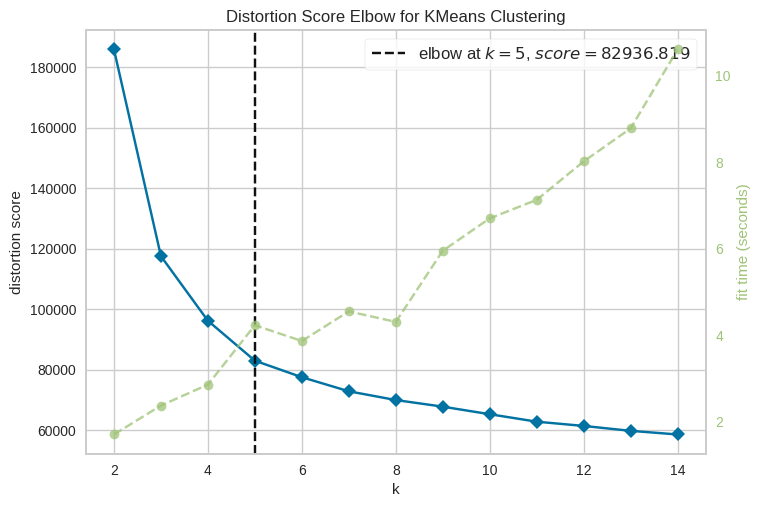

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Now, we can perform clustering on the above data
# Visualize performance of KMeans at various values k
# This approaches uses distortion score to evaluate KMeans
# Note: for clustering algorithms we must perform features scaling as they usually assumes features are in same scale

kmeans_model = KMeans(random_state=100)
visualizer = KElbowVisualizer(kmeans_model, k=(2, 15)) # calculates WCSS: within cluster sum square metric (distortion metric)

visualizer.fit(feat_scaled_df)
visualizer.show()

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:8

KElbowVisualizer(ax=<Axes: >, estimator=KMeans(n_clusters=20), k=(2, 21))

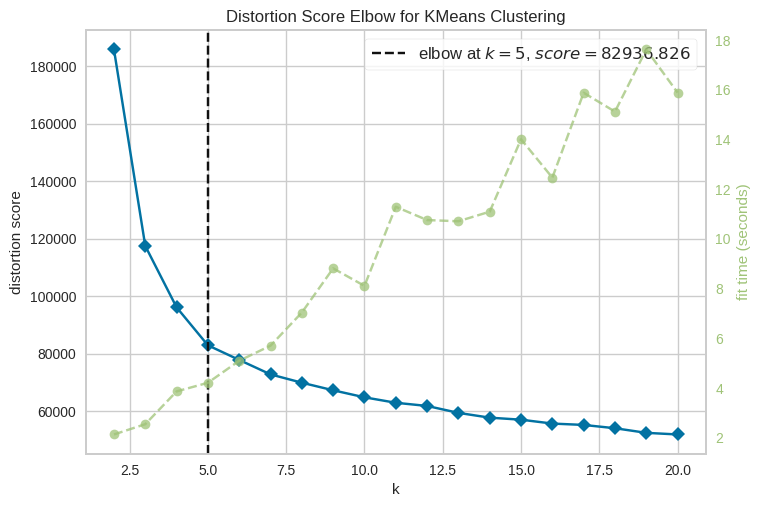

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Now, we can perform clustering on the above data
# Visualize performance of KMeans at various values k
# This approaches uses distortion score to evaluate KMeans
# Note: for clustering algorithms we must perform features scaling as they usually assumes features are in same scale

kmeans_model = KMeans()
visualizer = KElbowVisualizer(kmeans_model, k=(2, 21)) # calculates WCSS: within cluster sum square metric (distortion metric)

visualizer.fit(feat_scaled_df)
visualizer.show()

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 2, Silhouette Score: 0.49, Change from Previous Cluster: 0.0


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 3, Silhouette Score: 0.544, Change from Previous Cluster: 0.054


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 4, Silhouette Score: 0.336, Change from Previous Cluster: -0.208


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 5, Silhouette Score: 0.355, Change from Previous Cluster: 0.019


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 6, Silhouette Score: 0.31, Change from Previous Cluster: -0.045


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 7, Silhouette Score: 0.252, Change from Previous Cluster: -0.058


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 8, Silhouette Score: 0.251, Change from Previous Cluster: -0.001


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 9, Silhouette Score: 0.205, Change from Previous Cluster: -0.046


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 10, Silhouette Score: 0.184, Change from Previous Cluster: -0.021


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 11, Silhouette Score: 0.181, Change from Previous Cluster: -0.003


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 12, Silhouette Score: 0.175, Change from Previous Cluster: -0.006


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 13, Silhouette Score: 0.168, Change from Previous Cluster: -0.007


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No. Clusters: 14, Silhouette Score: 0.171, Change from Previous Cluster: 0.003


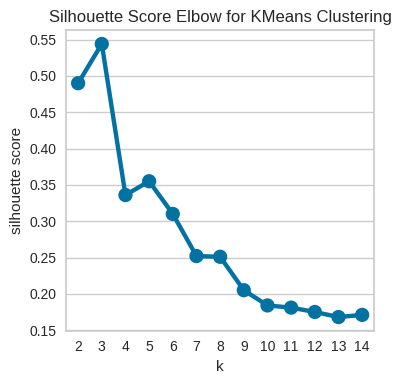

In [ ]:
# Evaluate KMeans at various values k, Silhouette score is open used
# Define a function to test KMeans at various k
# This approach uses silhouette score to evaluate KMeans
# Silhouette score is usually between -1, 0, 1
# Silhouette is slow on large data
# There is minibatch k-means for large data

def optimal_kmeans(dataset, start=2, end=15):
    '''
    Calculate the optimal number of kmeans

    INPUT:
        dataset : dataframe. Dataset for k-means to fit
        start : int. Starting range of kmeans to test
        end : int. Ending range of kmeans to test
    OUTPUT:
        Values and line plot of Silhouette Score.
    '''

    # Create empty lists to store values for plotting graphs
    n_clu = []
    km_ss = []

    # Create a for loop to find optimal n_clusters
    for n_clusters in range(start, end):

        # Create cluster labels
        kmeans = KMeans(n_clusters=n_clusters)
        labels = kmeans.fit_predict(dataset)

        # Calcualte model performance
        silhouette_avg = round(silhouette_score(dataset, labels,
                                                random_state=1), 3)

        # Append score to lists
        km_ss.append(silhouette_avg)
        n_clu.append(n_clusters)

        print("No. Clusters: {}, Silhouette Score: {}, Change from Previous Cluster: {}".format(
            n_clusters,
            silhouette_avg,
            (km_ss[n_clusters - start] - km_ss[n_clusters - start - 1]).round(3)))

        # Plot graph at the end of loop
        if n_clusters == end - 1:
            plt.figure(figsize=(4,4))

            plt.title('Silhouette Score Elbow for KMeans Clustering')
            plt.xlabel('k')
            plt.ylabel('silhouette score')
            sns.pointplot(x=n_clu, y=km_ss)
            plt.savefig('silhouette_score.png', format='png', dpi=300,
                        pad_inches=2.0)
            plt.tight_layout()
            plt.show()

optimal_kmeans(feat_scaled_df, 2, 15)

In [ ]:
kmeans_model = KMeans(random_state=100, n_clusters = 5)
cards_clusters = kmeans_model.fit_predict(feat_scaled_df)

feat_scaled_df_score = feat_scaled_df.reset_index(level=['score']) # reconverting the score from index to column
feat_scaled_df_score['cluster'] = cards_clusters # adding the predicted cluster to the dataframe

# checking that the userscore and cluster columns are added to the dataframe
feat_scaled_df_score.head()

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,score,card_relative_age,auth_hist_transactions_count,auth_hist_category_1_sum,auth_hist_installments_max,auth_hist_installments_min,auth_hist_installments_mean,auth_hist_month_lag_mean,auth_hist_purchase_amount_max,auth_hist_purchase_amount_min,auth_hist_purchase_amount_mean,auth_hist_purchase_amount_sum,auth_hist_merch_numerical_1_mean,auth_hist_merch_numerical_2_mean,auth_hist_merch_category_1_sum,auth_hist_merch_avg_sales_lag3_mean,auth_hist_merch_avg_purchases_lag3_mean,auth_hist_merch_active_months_lag3_mean,auth_hist_merch_avg_sales_lag12_max,auth_hist_merch_avg_sales_lag12_min,auth_hist_merch_avg_sales_lag12_mean,auth_hist_merch_avg_purchases_lag12_max,auth_hist_merch_avg_purchases_lag12_min,auth_hist_merch_avg_purchases_lag12_mean,auth_hist_merch_active_months_lag12_max,auth_hist_merch_active_months_lag12_min,auth_hist_merch_active_months_lag12_mean,auth_hist_merch_category_4_sum,unauth_hist_transactions_count,unauth_hist_category_1_sum,unauth_hist_installments_max,unauth_hist_installments_min,unauth_hist_installments_mean,unauth_hist_month_lag_mean,unauth_hist_purchase_amount_max,unauth_hist_purchase_amount_min,unauth_hist_purchase_amount_mean,unauth_hist_purchase_amount_sum,unauth_hist_merch_numerical_1_mean,unauth_hist_merch_numerical_2_mean,unauth_hist_merch_category_1_sum,unauth_hist_merch_avg_sales_lag3_mean,unauth_hist_merch_avg_purchases_lag3_mean,unauth_hist_merch_active_months_lag3_mean,unauth_hist_merch_avg_sales_lag12_max,unauth_hist_merch_avg_sales_lag12_min,unauth_hist_merch_avg_sales_lag12_mean,unauth_hist_merch_avg_purchases_lag12_max,unauth_hist_merch_avg_purchases_lag12_min,unauth_hist_merch_avg_purchases_lag12_mean,unauth_hist_merch_active_months_lag12_max,unauth_hist_merch_active_months_lag12_min,unauth_hist_merch_active_months_lag12_mean,unauth_hist_merch_category_4_sum,new_transactions_count,new_category_1_sum,new_installments_max,new_installments_min,new_installments_mean,new_month_lag_mean,new_purchase_amount_max,new_purchase_amount_min,new_purchase_amount_mean,new_purchase_amount_sum,new_merch_numerical_1_mean,new_merch_numerical_2_mean,new_merch_category_1_sum,new_merch_avg_sales_lag3_mean,new_merch_avg_purchases_lag3_mean,new_merch_active_months_lag3_mean,new_merch_avg_sales_lag12_max,new_merch_avg_sales_lag12_min,new_merch_avg_sales_lag12_mean,new_merch_avg_purchases_lag12_max,new_merch_avg_purchases_lag12_min,new_merch_avg_purchases_lag12_mean,new_merch_active_months_lag12_max,new_merch_active_months_lag12_min,new_merch_active_months_lag12_mean,new_merch_category_4_sum,cluster
card_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
C_ID_92a2005557,-0.820,0.107,0.097,0.000,0.000,0.000,0.000,0.692,0.016,0.000,0.003,0.306,0.099,0.096,0.033,0.000,0.000,1.000,0.000,0.898,0.000,0.011,0.009,0.002,1.000,0.545,0.963,0.093,0.009,0.000,0.083,0.000,0.026,0.657,0.000,0.000,0.000,0.000,0.093,0.091,0.002,0.000,0.000,1.000,0.000,0.000,0.000,0.011,0.000,0.001,1.000,0.583,0.968,0.008,0.211,0.000,0.000,0.000,0.000,0.739,0.006,0.001,0.004,0.320,0.150,0.150,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.417,0.967,0.229,3
C_ID_3d0044924f,0.393,0.173,0.133,0.044,0.833,0.054,0.124,0.599,0.029,0.000,0.003,0.296,0.184,0.182,0.068,0.000,0.000,1.000,0.000,0.895,0.000,0.011,0.006,0.000,1.000,0.545,0.973,0.122,0.007,0.001,0.833,0.083,0.318,0.657,0.000,0.000,0.000,0.000,0.089,0.086,0.001,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,1.000,0.007,0.055,0.000,0.083,0.083,0.083,0.750,0.001,0.000,0.000,0.369,0.003,0.003,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,1.000,0.072,0
C_ID_d639edf6cd,0.688,0.240,0.015,0.000,0.000,0.000,0.000,0.325,0.003,0.001,0.002,0.329,0.009,0.008,0.002,0.000,0.000,1.000,0.000,0.903,0.000,0.000,0.049,0.000,1.000,0.545,0.978,0.015,0.001,0.000,0.000,0.000,0.000,0.154,0.000,0.000,0.000,0.000,0.001,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,1.000,0.001,0.009,0.000,0.

In [ ]:
# visualizing the clusters after further dimensionality redcution

tsne = TSNE(n_components =2, verbose =1, perplexity = 30, n_iter = 300)
tsne_results = tsne.fit_transform(feat_scaled_df)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 199700 samples in 0.077s...
[t-SNE] Computed neighbors for 199700 samples in 169.982s...
[t-SNE] Computed conditional probabilities for sample 1000 / 199700
[t-SNE] Computed conditional probabilities for sample 2000 / 199700
[t-SNE] Computed conditional probabilities for sample 3000 / 199700
[t-SNE] Computed conditional probabilities for sample 4000 / 199700
[t-SNE] Computed conditional probabilities for sample 5000 / 199700
[t-SNE] Computed conditional probabilities for sample 6000 / 199700
[t-SNE] Computed conditional probabilities for sample 7000 / 199700
[t-SNE] Computed conditional probabilities for sample 8000 / 199700
[t-SNE] Computed conditional probabilities for sample 9000 / 199700
[t-SNE] Computed conditional probabilities for sample 10000 / 199700
[t-SNE] Computed conditional probabilities for sample 11000 / 199700
[t-SNE] Computed conditional probabilities for sample 12000 / 199700
[t-SNE] Computed conditional proba

In [ ]:
feat_scaled_df_tsne = feat_scaled_df_score.copy() # copying the df
feat_scaled_df_tsne["tsne-2d-one"] = tsne_results[:,0] # inserting new column
feat_scaled_df_tsne["tsne-2d-two"] = tsne_results[:,1] # inserting new column

<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/4270035277.py:2: UserWarning: The palette list has more values (6) than needed (5), which may not be intended.
  sns.scatterplot(x = "tsne-2d-one",


<Axes: xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

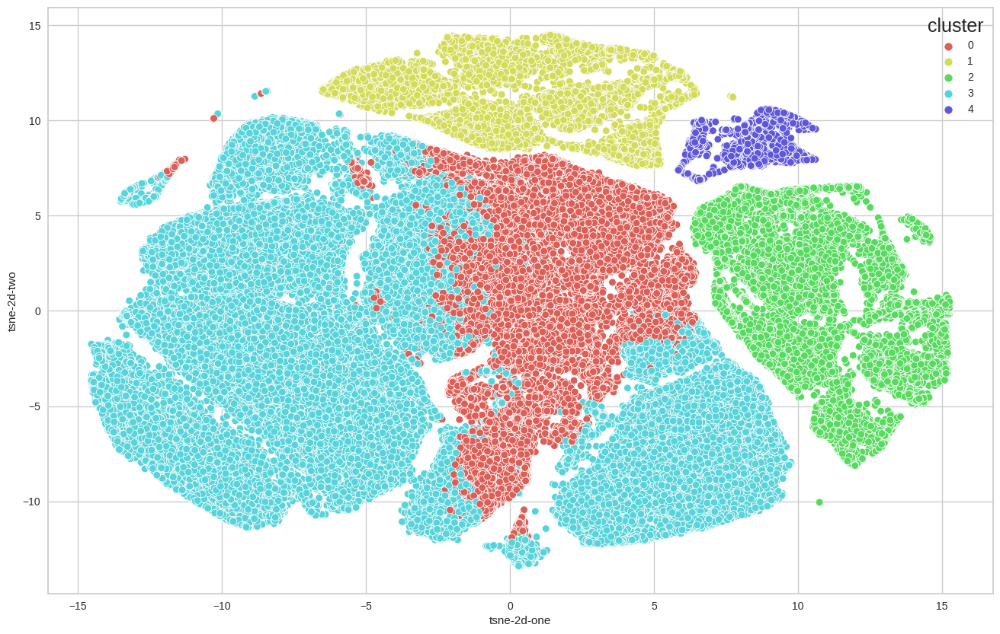

In [ ]:
# plotting TSNE
plt.figure(figsize=(16,10))
sns.scatterplot(x = "tsne-2d-one",
                y = "tsne-2d-two",
                hue="cluster",
                palette = sns.color_palette("hls"),
                data = feat_scaled_df_tsne,
                legend = 'full'
)

## Statistics of loyalty scores for each cluster of users.

- In this part we analyze the userscore statistics of each cluster. A good performed clustering will result in good separation of userscores and each cluster should have different userscore statistics.

- As will be shown below we used different ways to check the difference of userscore between clusters and unfortunately as expected the clustering result is bad and the userscore statistics is approximately equal across different clusters which indicates bad and ineffective clusters

In [ ]:
feat_scaled_df_score.groupby('cluster').describe()['score']

,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,49689.000,-0.126,1.516,-17.493,-0.809,-0.044,0.647,17.676
1,17268.000,0.949,2.199,-14.251,-0.240,0.652,2.134,15.994
2,26697.000,-0.070,1.711,-17.442,-0.925,-0.030,0.821,15.011
3,101952.000,-0.172,1.646,-17.608,-0.933,-0.099,0.653,15.295
4,4094.000,0.751,1.945,-8.103,-0.037,0.210,1.699,17.965


<Axes: title={'center': 'Clusters Sizes'}, xlabel='Cluster', ylabel='Size'>

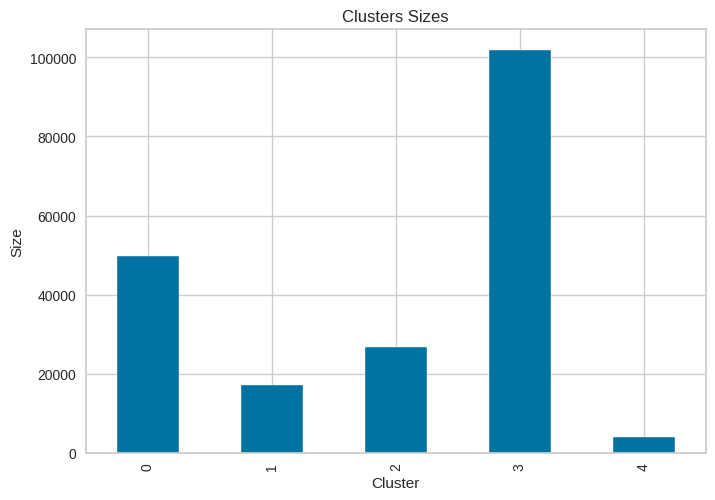

<Axes: title={'center': 'Mean Userscore'}, xlabel='Cluster'>

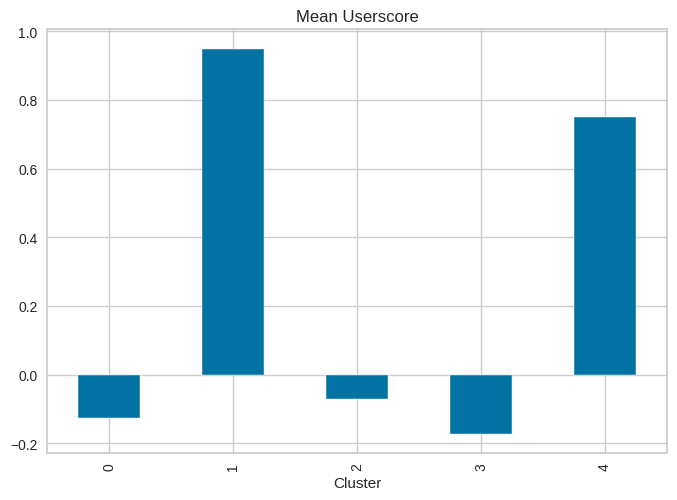

<Axes: title={'center': 'Median Userscore'}, xlabel='Cluster'>

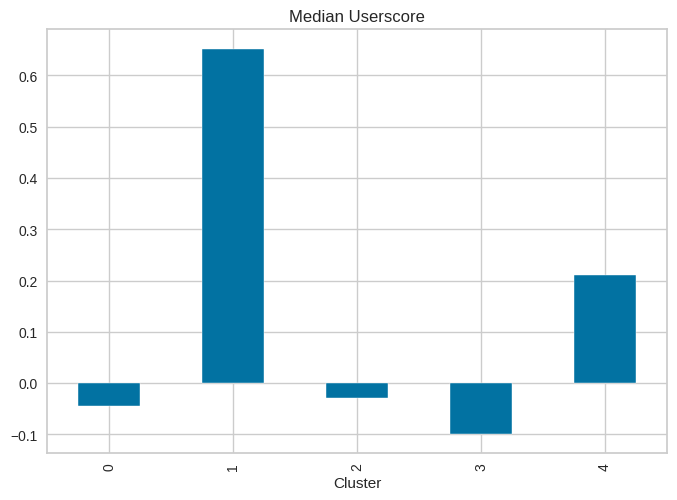

<Axes: title={'center': 'Minimum Userscore'}, xlabel='Cluster'>

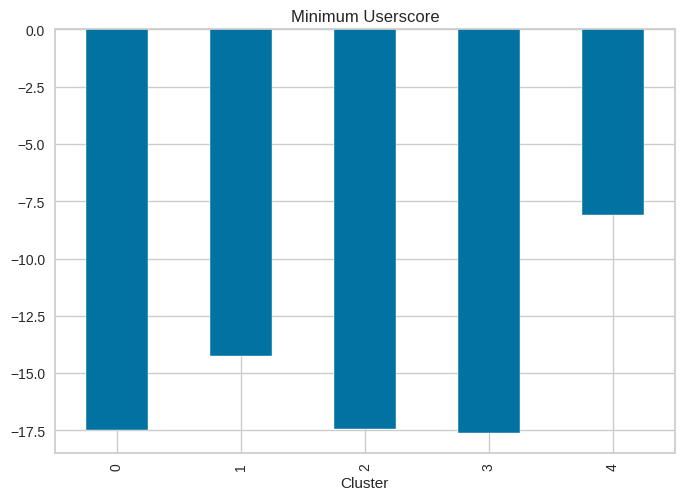

<Axes: title={'center': 'Maximum Userscore'}, xlabel='Cluster'>

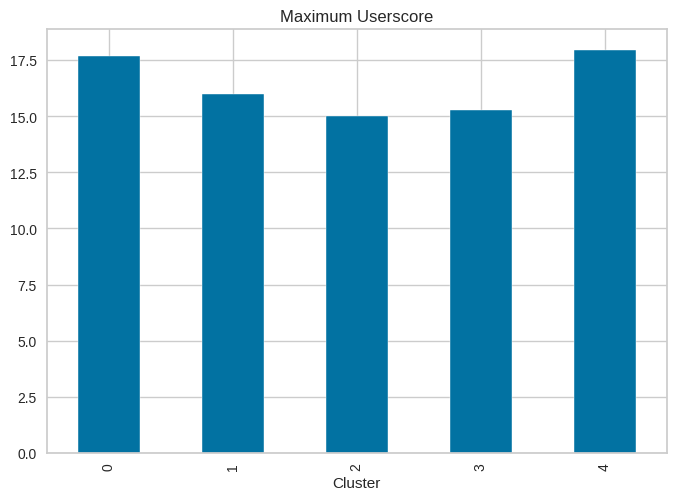

In [ ]:
# Plotting Cluster sizes
feat_scaled_df_score.groupby('cluster').size().plot(kind='bar', title='Clusters Sizes', xlabel = 'Cluster', ylabel='Size')
plt.show()

# Plotting Mean Userscore for each cluster
feat_scaled_df_score.groupby('cluster').mean()['score'].plot(kind='bar', title='Mean Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Median Userscore for each cluster
feat_scaled_df_score.groupby('cluster').median()['score'].plot(kind='bar', title='Median Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Minimum Userscore for each cluster
feat_scaled_df_score.groupby('cluster').min()['score'].plot(kind='bar', title='Minimum Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Maximum Userscore for each cluster
feat_scaled_df_score.groupby('cluster').max()['score'].plot(kind='bar', title='Maximum Userscore', xlabel = 'Cluster')
plt.show()


In [ ]:
#frequency plot
fig = px.histogram(feat_scaled_df_score, x="score", color="cluster", marginal="box" ) # marginal can be 'rug', `box`, `violin`
fig.show()

#box plot
fig = px.box(feat_scaled_df_score, x="cluster", y="score", color="cluster")
fig.show()

![image.png](attachment:acefcce6-4279-4a62-9cd2-0805f2faad7c.png)

![image.png](attachment:fe4e2497-8a61-4384-96f3-32eea4dc5653.png)

## Discussing whether we need to reduce the dimensions to improve clustering performance and build another clustering model to improve your analysis.

### Trial 2: K-means clustering after performing PCA to reduce number of features (MLE is used to guess number of components)

- As we have seen in previous section using a large number of features resulted in poor clustering and the unability to explain or visualize the clusters proberly.
- A common approach would suggest performing dimensionality reduction to reduce the number of features as well as perserving the variance in the data, to do so we used PCA.
- We used PCA to reduce number of features in which we set "n_components" parameter to "3" to be able to visualize the resultant clusters,
- We can use "n_components" to "mle" such that the appropriate number of components to be determined using MLE but it was still large so we decided to go with 3 components in sake of better visualization given that the 3 components covers about ~79% of expalined variance.
- A disadvantage of performing dimensionality reduction is that we can't interpret the resultant clusters, as the resultant principal components on which the data is projected are longer representing known features or quantities.
- In this part we obtained the K value using the Elbow method only as the Silhouette score method has taken ~2 hours in the previous trial.
- As will be shown the resultant clusters here were also bad as in case of not using PCA, both models are extemely poor which indicates that the data used for clustering is not suitable and needs further exploration and tuning to obtain more discriminative features to be able to separate the clusters
- We tried also to reduce number of dimensions further to two and visualize clusters using TSNE however the result was very poor.
- We thought of trying PCA with n_components set to "mle" then apply TSNE for better dimensionality reduction and we carried this out as final trial.
- A possible reason that can be causing this bad results maybe is the outliers that need more special focus to remove appropriately.

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


#scaler = StandardScaler()
#feat_stand_scaled = scaler.fit_transform(merged_data_ed)
#feat_stand_scaled_df = pd.DataFrame(feat_stand_scaled, columns = merged_data_ed.columns, index = merged_data_ed.index )
#feat_stand_scaled_df.describe()
#feat_stand_scaled_df.head()


# as per sklearn's documentation PCA centers the data at zero mean and for having unit variance we set "whiten=True"
# So no need to scale the data ourselves as it is done as part of PCA algorithm

pca = PCA(n_components="mle", whiten=True)
pca_feat = pca.fit_transform(merged_data_ed) # pass the original data

pca_feat_df = pd.DataFrame(pca_feat, index = merged_data_ed.index )
pca_feat_df.describe()
pca_feat_df.head()

,0,1,2
count,199700.000,199700.000,199700.000
mean,0.000,-0.000,0.000
std,1.000,1.000,1.000
min,-0.104,-0.027,-4.892
25%,-0.098,-0.004,-0.014
50%,-0.098,-0.004,-0.014
75%,-0.095,-0.004,-0.014
max,36.525,446.108,114.840


,,0,1,2
card_id,score,,,
C_ID_92a2005557,-0.820,-0.095,-0.004,-0.006
C_ID_3d0044924f,0.393,-0.095,-0.004,-0.014
C_ID_d639edf6cd,0.688,-0.098,-0.004,-0.014
C_ID_186d6a6901,0.142,-0.098,-0.004,-0.014
C_ID_cdbd2c0db2,-0.160,-0.095,-0.003,-0.014


In [ ]:
print("Explained variantion per principal component: {}".format(pca.explained_variance_ratio_))

Explained variantion per principal component: [0.77629328 0.10618051 0.07200404]


/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:8

KElbowVisualizer(ax=<Axes: >, estimator=KMeans(n_clusters=14, random_state=100),
                 k=(2, 15))

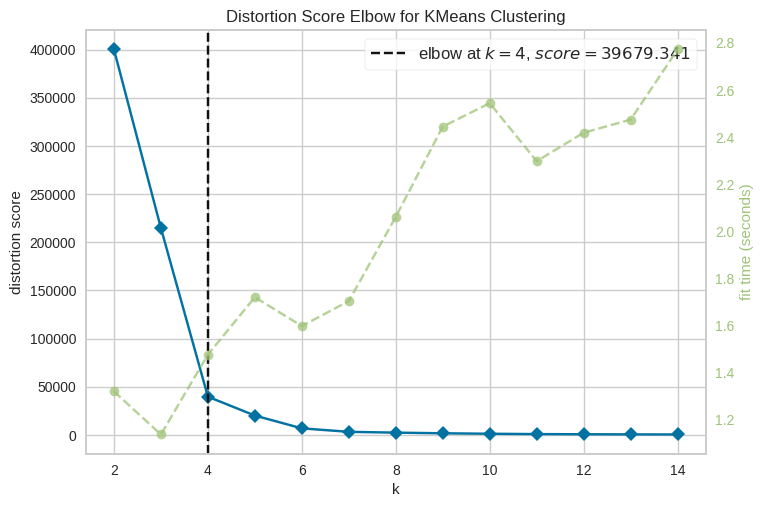

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Now, we can perform clustering on the above data
# Visualize performance of KMeans at various values k
# This approaches uses distortion score to evaluate KMeans
# Note: for clustering algorithms we must perform features scaling as they usually assumes features are in same scale

kmeans_model_pca = KMeans(random_state=100)
visualizer_pca = KElbowVisualizer(kmeans_model_pca, k=(2, 15)) # calculates WCSS: within cluster sum square metric (distortion metric)

visualizer_pca.fit(pca_feat_df)
visualizer_pca.show()

In [ ]:
kmeans_model_pca = KMeans(random_state=100, n_clusters = 4)
cards_clusters_pca = kmeans_model_pca.fit_predict(pca_feat_df)

pca_feat_df_score = pca_feat_df.reset_index(level=['score']) # reconverting the score from index to column
pca_feat_df_score['cluster'] = cards_clusters_pca # adding the predicted cluster to the dataframe
pca_feat_df_score.head()

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,score,0,1,2,cluster
card_id,,,,,
C_ID_92a2005557,-0.820,-0.095,-0.004,-0.006,0
C_ID_3d0044924f,0.393,-0.095,-0.004,-0.014,0
C_ID_d639edf6cd,0.688,-0.098,-0.004,-0.014,0
C_ID_186d6a6901,0.142,-0.098,-0.004,-0.014,0
C_ID_cdbd2c0db2,-0.160,-0.095,-0.003,-0.014,0


<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/3010623982.py:2: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(x=0, y =1, hue="cluster",


<Axes: xlabel='0', ylabel='1'>

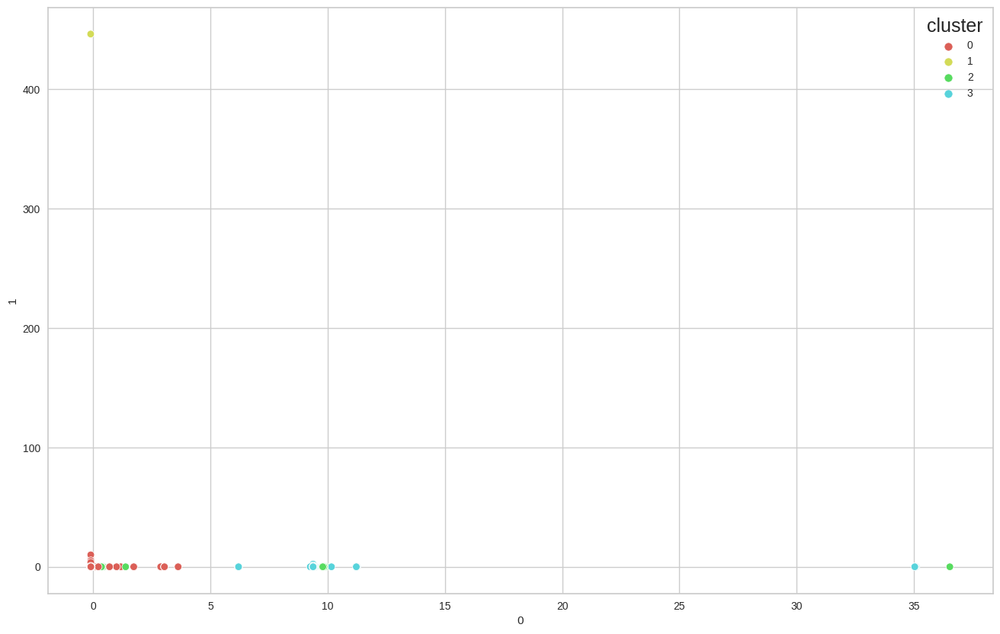

In [ ]:
# principal component 1 vs principal component 2
plt.figure(figsize=(16,10))
sns.scatterplot(x=0, y =1, hue="cluster",
                palette = sns.color_palette("hls"),
                data = pca_feat_df_score,
                legend = 'full'
)

<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/1554750744.py:4: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(x=0, y =2, hue="cluster",


<Axes: xlabel='0', ylabel='2'>

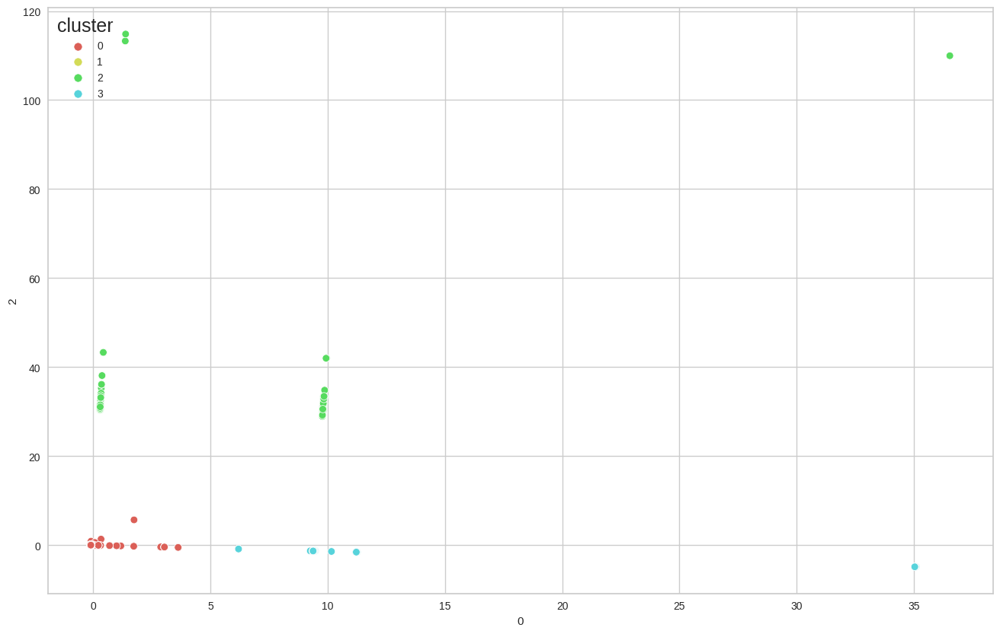

In [ ]:
# principal component 1 vs principal component 3

plt.figure(figsize=(16,10))
sns.scatterplot(x=0, y =2, hue="cluster",
                palette = sns.color_palette("hls"),
                data = pca_feat_df_score,
                legend = 'full'
)

<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/1603266091.py:4: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(x=1, y =2, hue="cluster",


<Axes: xlabel='1', ylabel='2'>

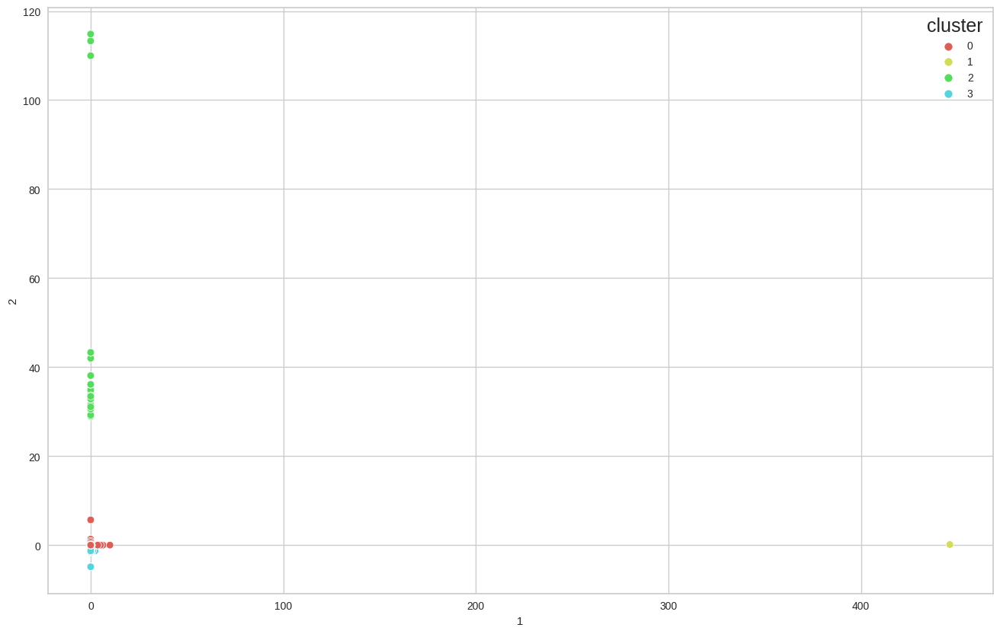

In [ ]:
# principal component 2 vs principal component 3

plt.figure(figsize=(16,10))
sns.scatterplot(x=1, y =2, hue="cluster",
                palette = sns.color_palette("hls"),
                data = pca_feat_df_score,
                legend = 'full'
)

- Since the resultant number of principal components is just 3 we can try to visualize the clusters in a 3D plot.
- They seem to vary according to feature 2 and feature 0 but as discussed these features are uninterpretable

In [ ]:
# Plotting the features against each other in the 3D space since they are only 3 features
import plotly.express as px
fig = px.scatter_3d(data_frame = pca_feat_df_score,
                    x=0,
                    y=1,
                    z=2,
                    color='cluster',
                   color_discrete_sequence=px.colors.qualitative.D3,
                   category_orders={"cluster": ["0","1","2", "3"]})
fig.show()

![image.png](attachment:638a989f-4352-4da9-9832-fe0145b67ffa.png)

In [ ]:
# visualizing the clusters after further dimensionality redcution

tsne = TSNE(n_components =2, verbose =1, perplexity = 40, n_iter = 300)
tsne_results = tsne.fit_transform(pca_feat_df)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 199700 samples in 0.155s...
[t-SNE] Computed neighbors for 199700 samples in 12.911s...
[t-SNE] Computed conditional probabilities for sample 1000 / 199700
[t-SNE] Computed conditional probabilities for sample 2000 / 199700
[t-SNE] Computed conditional probabilities for sample 3000 / 199700
[t-SNE] Computed conditional probabilities for sample 4000 / 199700
[t-SNE] Computed conditional probabilities for sample 5000 / 199700
[t-SNE] Computed conditional probabilities for sample 6000 / 199700
[t-SNE] Computed conditional probabilities for sample 7000 / 199700
[t-SNE] Computed conditional probabilities for sample 8000 / 199700
[t-SNE] Computed conditional probabilities for sample 9000 / 199700
[t-SNE] Computed conditional probabilities for sample 10000 / 199700
[t-SNE] Computed conditional probabilities for sample 11000 / 199700
[t-SNE] Computed conditional probabilities for sample 12000 / 199700
[t-SNE] Computed conditional proba

In [ ]:
pca_feat_df_score_tsne = pca_feat_df_score.copy() # copying df
pca_feat_df_score_tsne["tsne-2d-one"] = tsne_results[:,0] # inserting a new column
pca_feat_df_score_tsne["tsne-2d-two"] = tsne_results[:,1] # inserting a new column

<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/994562085.py:2: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(x = "tsne-2d-one",


<Axes: xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

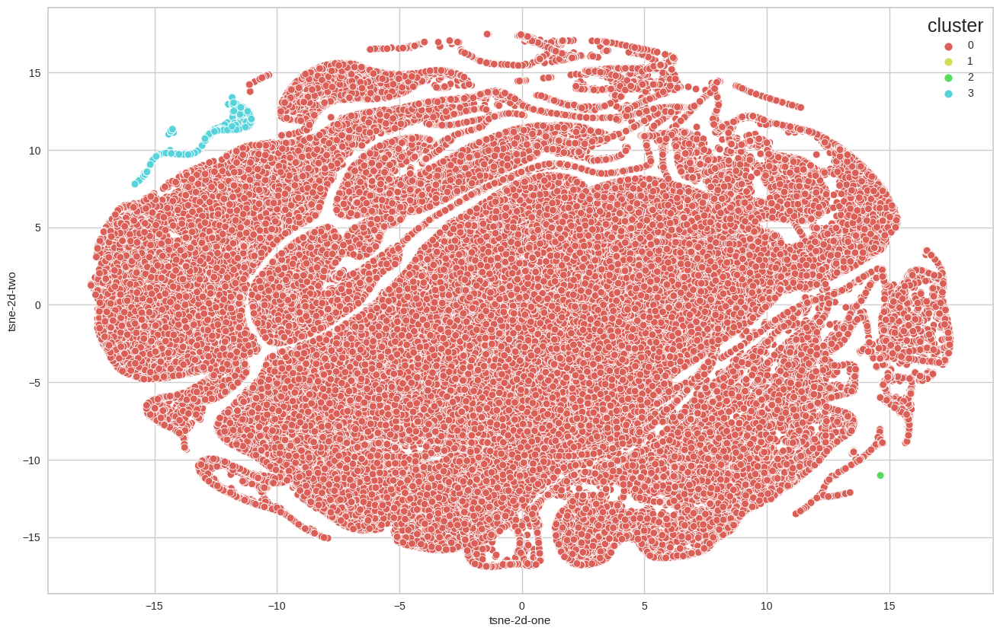

In [ ]:
# plotting TSNE
plt.figure(figsize=(16,10))
sns.scatterplot(x = "tsne-2d-one",
                y = "tsne-2d-two",
                hue="cluster",
                palette = sns.color_palette("hls"),
                data = pca_feat_df_score_tsne,
                legend = 'full'
)

## Reporting the statistics of loyalty scores for each cluster of users.

- From below table we can notice that cluster number 1 contains only 1 card id and the majority of cards lies in category 0

- As will be shown below we used different ways to check the difference of userscore between clusters and unfortunately the clustering result is bad and the userscore statistics is approximately equal across different clusters which indicates bad and ineffective clusters even after performing PCA which strongly suggests that the features we started with in the first place need tuning and more carefull choice or maybe deriving more descriminative features as the RFM model using the recency, frequency and the monetary value, derving these features will also improve the explainability of the resultant clusters alot as we will be able to understand the clusters in which users will lie in based on their purchasing behaviour.

In [ ]:
pca_feat_df_score.groupby('cluster').describe()['score']


,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,197649.000,-0.030,1.719,-17.608,-0.844,-0.007,0.780,17.965
1,1.000,0.073,NaN,0.073,0.073,0.073,0.073,0.073
2,160.000,-0.180,1.633,-5.855,-0.901,-0.123,0.610,5.547
3,1890.000,-0.138,1.551,-9.876,-0.843,-0.056,0.590,8.609


<Axes: title={'center': 'Clusters Sizes'}, xlabel='Cluster', ylabel='Size'>

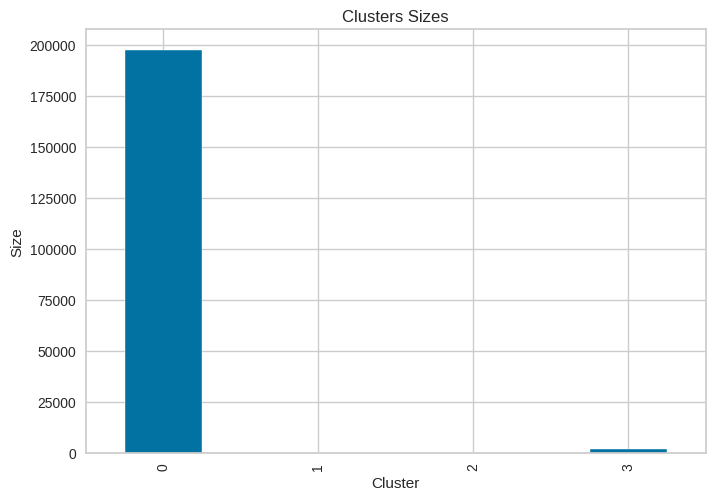

<Axes: title={'center': 'Mean Userscore'}, xlabel='Cluster'>

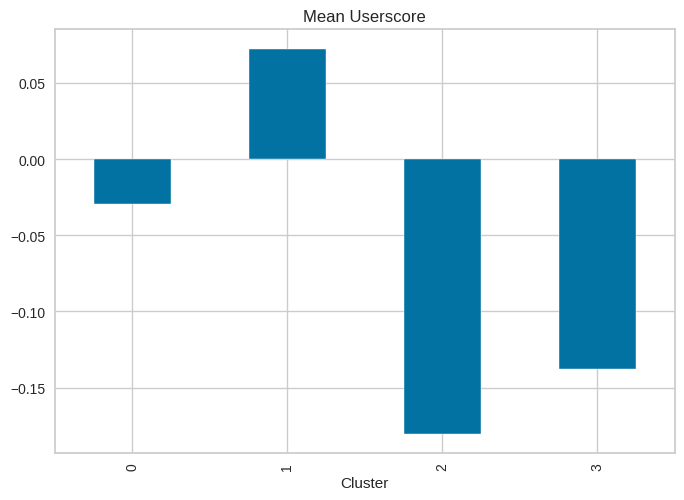

<Axes: title={'center': 'Median Userscore'}, xlabel='Cluster'>

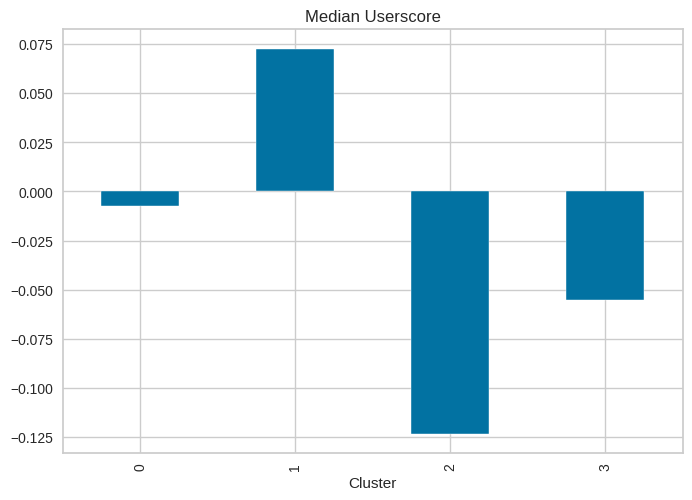

<Axes: title={'center': 'Minimum Userscore'}, xlabel='Cluster'>

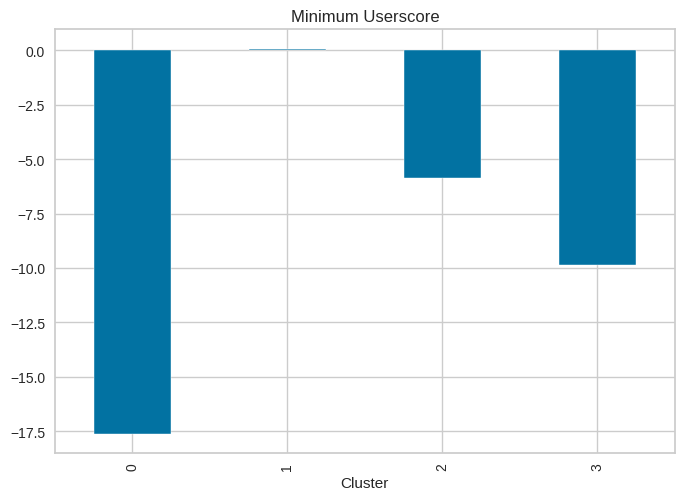

<Axes: title={'center': 'Maximum Userscore'}, xlabel='Cluster'>

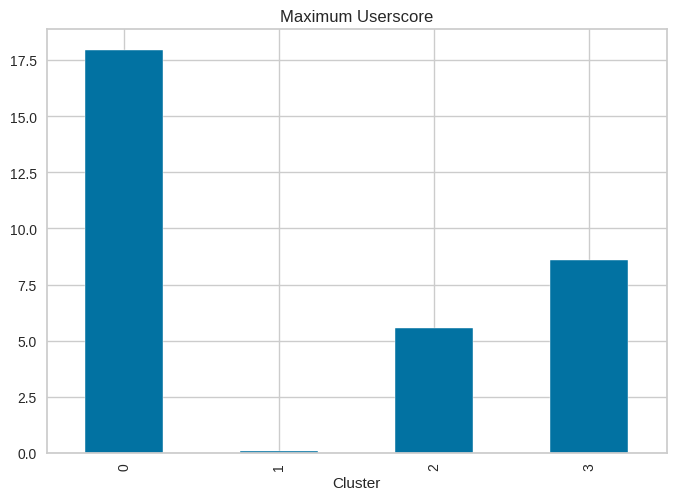

In [ ]:
# Plotting Cluster sizes
pca_feat_df_score.groupby('cluster').size().plot(kind='bar', title='Clusters Sizes', xlabel = 'Cluster', ylabel='Size')
plt.show()

# Plotting Mean Userscore for each cluster
pca_feat_df_score.groupby('cluster').mean()['score'].plot(kind='bar', title='Mean Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Median Userscore for each cluster
pca_feat_df_score.groupby('cluster').median()['score'].plot(kind='bar', title='Median Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Minimum Userscore for each cluster
pca_feat_df_score.groupby('cluster').min()['score'].plot(kind='bar', title='Minimum Userscore', xlabel = 'Cluster')
plt.show()

# Plotting Maximum Userscore for each cluster
pca_feat_df_score.groupby('cluster').max()['score'].plot(kind='bar', title='Maximum Userscore', xlabel = 'Cluster')
plt.show()

#frequency plot
fig = px.histogram(pca_feat_df_score, x="score", color="cluster", marginal="box" ) # marginal can be 'rug', `box`, `violin`
fig.show()

#box plot
fig = px.box(pca_feat_df_score, x="cluster", y="score", color="cluster")
fig.show()

![image.png](attachment:927d03de-c155-485c-a542-ea45fe7ffb83.png)

![image.png](attachment:ddfb9feb-da12-456a-86f7-73035999431b.png)

## Final Trial by performing PCA with n_components set to "mle" for pca to find optimal number of dimensions, then fit a kmeans clustering model with these new components, finally for better visualization of resultant clusters we reduce the PCA features to just 2 features using TSNE to be able to plot a 2D figure.

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 199700 samples in 0.072s...
[t-SNE] Computed neighbors for 199700 samples in 171.734s...
[t-SNE] Computed conditional probabilities for sample 1000 / 199700
[t-SNE] Computed conditional probabilities for sample 2000 / 199700
[t-SNE] Computed conditional probabilities for sample 3000 / 199700
[t-SNE] Computed conditional probabilities for sample 4000 / 199700
[t-SNE] Computed conditional probabilities for sample 5000 / 199700
[t-SNE] Computed conditional probabilities for sample 6000 / 199700
[t-SNE] Computed conditional probabilities for sample 7000 / 199700
[t-SNE] Computed conditional probabilities for sample 8000 / 199700
[t-SNE] Computed conditional probabilities for sample 9000 / 199700
[t-SNE] Computed conditional probabilities for sample 10000 / 199700
[t-SNE] Computed conditional probabilities for sample 11000 / 199700
[t-SNE] Computed conditional probabilities for sample 12000 / 199700
[t-SNE] Computed conditional prob

<Figure size 1600x1000 with 0 Axes>

/tmp/ipykernel_32/2821920436.py:24: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(x = "tsne-2d-one",


<Axes: xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

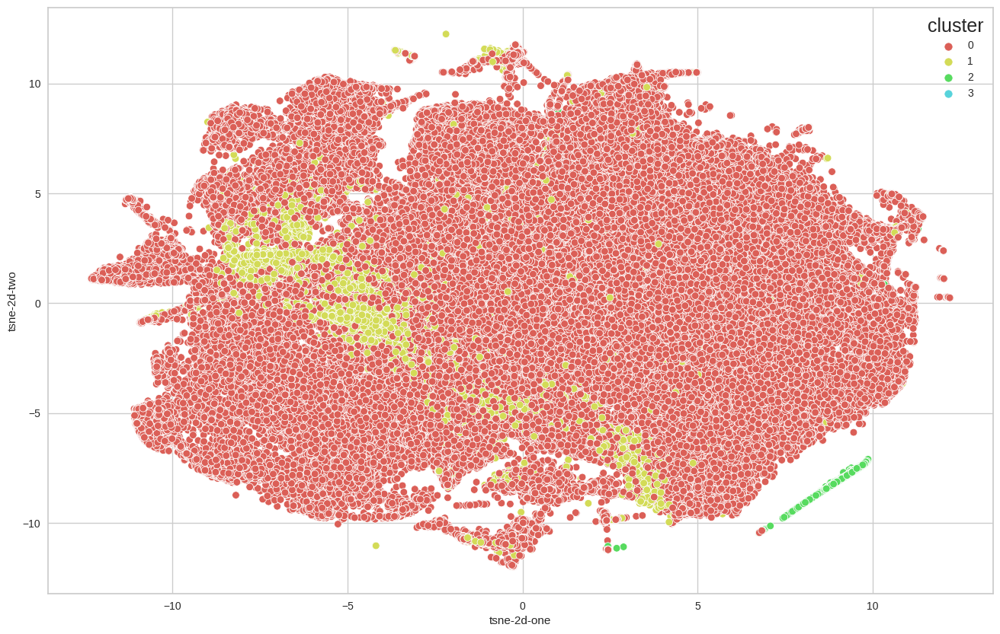

In [ ]:
# PCA - Dimensionality Reduction
pca = PCA(n_components="mle", whiten=True)
pca_feat = pca.fit_transform(merged_data_ed) # pass the original data

pca_feat_df = pd.DataFrame(pca_feat, index = merged_data_ed.index )

# K-means Model
kmeans_model_pca = KMeans(random_state=100, n_clusters = 4)
cards_clusters_pca = kmeans_model_pca.fit_predict(pca_feat_df)

pca_feat_df_score = pca_feat_df.reset_index(level=['score']) # reconverting the score from index to column
pca_feat_df_score['cluster'] = cards_clusters_pca # adding the predicted cluster to the dataframe

# visualizing the clusters after further dimensionality redcution
tsne = TSNE(n_components =2, verbose =1, perplexity = 40, n_iter = 300)
tsne_results = tsne.fit_transform(pca_feat_df)

pca_feat_df_score_tsne = pca_feat_df_score.copy() # copying df
pca_feat_df_score_tsne["tsne-2d-one"] = tsne_results[:,0] # inserting a new column
pca_feat_df_score_tsne["tsne-2d-two"] = tsne_results[:,1] # inserting a new column

# plotting TSNE
plt.figure(figsize=(16,10))
sns.scatterplot(x = "tsne-2d-one",
                y = "tsne-2d-two",
                hue="cluster",
                palette = sns.color_palette("hls"),
                data = pca_feat_df_score_tsne,
                legend = 'full'
)

from this trial and the previous one it seems that not using PCA leads to better clusters as per TSNE plots this can be due to outliers affecting the resultant principal components quality.

In [ ]:
print("Explained variance per principal component: {}".format(pca.explained_variance_ratio_))

Explained variance per principal component: [7.76293280e-01 1.06180512e-01 7.20040389e-02 3.28079591e-02
 7.57493031e-03 2.48766246e-03 8.29047276e-04 6.41016459e-04
 5.53195840e-04 2.38246248e-04 1.58191261e-04 1.41106718e-04
 3.10398875e-05 2.40256709e-05 1.37027219e-05 1.25696206e-05
 2.48655887e-06 2.29103111e-06 1.40015923e-06 1.04988135e-06
 6.21166974e-07 3.34785833e-07 3.22483639e-07 2.96653132e-07
 2.48288384e-07 1.00320571e-07 7.22166812e-08 5.28450835e-08
 4.45677640e-08 3.74800789e-08 2.48720816e-08 1.66488606e-08
 1.56221231e-08 1.33196848e-08 9.65646123e-09 7.92161925e-09
 6.17117118e-09 5.19565009e-09 3.87144219e-09 3.08282787e-09
 2.78510616e-09 1.10084944e-09 1.04835741e-09 9.08144297e-10
 8.54852543e-10 7.51481201e-10 6.92359643e-10 6.37724561e-10
 4.02682199e-10 3.65681473e-10 3.39653357e-10 2.39492732e-10
 2.20977310e-10 1.84779285e-10 1.06802525e-10 8.92678691e-11
 4.24066415e-11 3.70485349e-11 2.48060563e-11 2.24034805e-11
 1.98884914e-11 1.79406945e-11 1.49961562

explained variance per PC is very small!

# Frequent Pattern Mining

## Prepare data for frequent pattern Mining

Since we are preparing the data for frequent pattern mining we will not use numerical features


In [ ]:
# Getting Numerical columns
numeric_feat_newtr = list(new_transactions_merch.select_dtypes(include=['number']).columns)
numeric_feat_histtr = list(historical_transactions_merch.select_dtypes(include=['number']).columns)

#Dropping Numerical features
new_transactions_merch_cat = new_transactions_merch.drop(numeric_feat_newtr, axis=1)
historical_transactions_merch_cat = historical_transactions_merch.drop(numeric_feat_histtr, axis=1)

In [ ]:
# Saving merged data into a csv file to avoid re-running the code again to obtain this merging as it takes time
#new_transactions_merch_cat.to_csv('new_transactions_merch_cat_fpm.csv', index=False)
#historical_transactions_merch_cat.to_csv('historical_transactions_merch_cat_fpm.csv', index=False)


# Reading the saved file in case of runtime errors and ram crashes
#new_transactions_merch_cat = pd.read_csv('new_transactions_merch_cat_fpm.csv') # check path upon addin the data
#historical_transactions_merch_cat = pd.read_csv('historical_transactions_merch_cat_fpm.csv') # check path upon adding the data

In [ ]:
new_transactions_merch_cat.head()
historical_transactions_merch_cat.head()

,authorized_flag,card_id,city_id,category_1,category_3,merchant_category_id,merchant_id,purchase_date,category_2,state_id,subsector_id,merch_merchant_group_id,merch_merchant_category_id,merch_subsector_id,merch_category_1,merch_most_recent_sales_range,merch_most_recent_purchases_range,merch_category_4,merch_city_id,merch_state_id,merch_category_2
0,Y,C_ID_415bb3a509,107,N,B,307,M_ID_b0c793002c,2018-03-11 14:57:36,1.000,9,19,71460,307,19,N,C,C,N,-1,9,1.000
1,Y,C_ID_415bb3a509,140,N,B,307,M_ID_88920c89e8,2018-03-19 18:53:37,1.000,9,19,48955,307,19,N,B,B,N,140,9,1.000
2,Y,C_ID_415bb3a509,330,N,B,507,M_ID_ad5237ef6b,2018-04-26 14:08:44,1.000,9,14,24380,507,14,N,B,B,N,-1,9,1.000
3,Y,C_ID_415bb3a509,-1,Y,B,661,M_ID_9e84cda3b1,2018-03-07 09:43:21,1.000,-1,8,6938,661,8,Y,A,A,Y,-1,-1,1.000
4,Y,C_ID_ef55cf8d4b,-1,Y,B,166,M_ID_3c86fa3831,2018-03-22 21:07:53,1.000,-1,29,87381,166,29,Y,B,B,Y,-1,-1,1.000


,authorized_flag,card_id,city_id,category_1,category_3,merchant_category_id,merchant_id,purchase_date,category_2,state_id,subsector_id,merch_merchant_group_id,merch_merchant_category_id,merch_subsector_id,merch_category_1,merch_most_recent_sales_range,merch_most_recent_purchases_range,merch_category_4,merch_city_id,merch_state_id,merch_category_2
0,Y,C_ID_4e6213e9bc,88,N,A,80,M_ID_e020e9b302,2017-06-25 15:33:07,1.000,16,37,35,80,37,N,A,A,Y,88,16,1.000
1,Y,C_ID_4e6213e9bc,88,N,A,367,M_ID_86ec983688,2017-07-15 12:10:45,1.000,16,16,2084,367,16,N,A,A,Y,88,16,1.000
2,Y,C_ID_4e6213e9bc,88,N,A,80,M_ID_979ed661fc,2017-08-09 22:04:29,1.000,16,37,27369,80,37,N,C,C,Y,88,16,1.000
3,Y,C_ID_4e6213e9bc,88,N,A,560,M_ID_e6d5ae8ea6,2017-09-02 10:06:26,1.000,16,34,24104,560,34,N,D,C,Y,88,16,1.000
4,Y,C_ID_4e6213e9bc,88,N,A,80,M_ID_e020e9b302,2017-03-10 01:14:19,1.000,16,37,35,80,37,N,A,A,Y,88,16,1.000


In [ ]:
# adding new column to identify type of transaction
new_transactions_merch_cat['transaction_type'] = 'new'
historical_transactions_merch_cat['transaction_type'] = 'historical'

# adding the two dataframe into a single one to be merged with userscore data
all_transactions_df = pd.concat([historical_transactions_merch_cat, new_transactions_merch_cat], ignore_index = True)

In [ ]:
# Merging the userscore and transactions into one table
all_transactions_userscore_merged_fpm = pd.merge(userscore, all_transactions_df , on='card_id', how='left')

# We can check if the merging is done correctly in terms of total number of card_ids which should match that of userscore data
#transactions_userscore_merged_fpm.info()
#transactions_userscore_merged_fpm.head()


In [ ]:
# Saving merged data into a csv file to avoid re-running the code again to obtain this merging as it takes time
#all_transactions_userscore_merged_fpm.to_csv('all_transactions_userscore_merged_fpm.csv', index=False)

# Reading the saved file in case of runtime errors and ram crashes
all_transactions_userscore_merged_fpm = pd.read_csv('/kaggle/input/cisc839-a2-all-transactions-userscore-merged-fpm/all_transactions_userscore_merged_fpm.csv') # check path upon addin the data

In [ ]:
all_transactions_userscore_merged_fpm.head(3)

,card_id,feature_1,feature_2,feature_3,score,card_relative_age,authorized_flag,city_id,category_1,category_3,merchant_category_id,merchant_id,purchase_date,category_2,state_id,subsector_id,merch_merchant_group_id,merch_merchant_category_id,merch_subsector_id,merch_category_1,merch_most_recent_sales_range,merch_most_recent_purchases_range,merch_category_4,merch_city_id,merch_state_id,merch_category_2,transaction_type
0,C_ID_92a2005557,5,2,1,-0.820,245,Y,69,N,A,195,M_ID_cc72dac895,2017-11-25 16:37:11,1.000,9,34,35,195,34,N,A,A,Y,69,9,1.000,historical
1,C_ID_92a2005557,5,2,1,-0.820,245,Y,69,N,A,278,M_ID_c9c0f1cb3f,2017-07-16 12:21:00,1.000,9,37,72004,560,34,N,D,D,Y,69,9,1.000,historical
2,C_ID_92a2005557,5,2,1,-0.820,245,Y,69,N,A,683,M_ID_36f9e41993,2017-08-10 21:01:16,1.000,9,34,9215,683,34,N,C,B,Y,69,9,1.000,historical


Since the Apriori algorithm needs the data to be in a slightly different format than the conventional dataframe we’ll need to re-shape/re-format the data.

for Apriori to work, the data need to be reformatted so that each transaction is on one line, and each feature value is in its own column, with a one-hot encoded representation denoting whether the feature value appeared in the transaction or not. So it is basically performing one hot encoding for all features.

To perform one hot encoding we will first need to check each feature and the number of its unique items such that we can be able to select a subset of features that dont have very large number of unique values such that one hot encoding doesn't result in enourmous number of columns.

In [ ]:
# checking number of unique entries for each feature
cols_to_drop = []

for col in all_transactions_userscore_merged_fpm.columns:

    if len(np.unique(all_transactions_userscore_merged_fpm[col])) > 30:
        cols_to_drop.append(col)

    print(all_transactions_userscore_merged_fpm[col].value_counts()) # to print count of every category
    print("\n")
    print("----------------------------------------------------------")
    print("\n")

C_ID_0cd2ce025c    2915
C_ID_cc3d4cd4e3    2192
C_ID_5ccc07beb9    2072
C_ID_5ea401d358    1786
C_ID_9f81506906    1672
                   ... 
C_ID_22df161ffe       2
C_ID_1e3c6b4f44       2
C_ID_8e1df62a18       2
C_ID_2f90c173ef       2
C_ID_6762df0a84       2
Name: card_id, Length: 199710, dtype: int64


----------------------------------------------------------


3    6308289
2    4592398
5    4213591
4    2138191
1    1809659
Name: feature_1, dtype: int64


----------------------------------------------------------


2    8197800
1    7890346
3    2973982
Name: feature_2, dtype: int64


----------------------------------------------------------


1    10521880
0     8540248
Name: feature_3, dtype: int64


----------------------------------------------------------


0.000     50965
1.000      3878
0.109      2915
-1.000     2436
-1.230     2192
          ...  
0.170         3
0.802         2
0.843         2
1.726         2
-0.462        2
Name: score, Length: 197109, dtype: int64


In [ ]:
# displaying columns to be dropped due to having more than 30 unique values and will explode the one hot encoding columns
cols_to_drop

['card_id',
 'score',
 'card_relative_age',
 'city_id',
 'merchant_category_id',
 'merchant_id',
 'purchase_date',
 'subsector_id',
 'merch_merchant_group_id',
 'merch_merchant_category_id',
 'merch_subsector_id',
 'merch_city_id']

In [ ]:
# dropping columns that have more than 30 unique values
fpm_transactions = all_transactions_userscore_merged_fpm.drop(cols_to_drop, axis=1)
fpm_transactions.head()

,feature_1,feature_2,feature_3,authorized_flag,category_1,category_3,category_2,state_id,merch_category_1,merch_most_recent_sales_range,merch_most_recent_purchases_range,merch_category_4,merch_state_id,merch_category_2,transaction_type
0,5,2,1,Y,N,A,1.000,9,N,A,A,Y,9,1.000,historical
1,5,2,1,Y,N,A,1.000,9,N,D,D,Y,9,1.000,historical
2,5,2,1,Y,N,A,1.000,9,N,C,B,Y,9,1.000,historical
3,5,2,1,Y,N,A,1.000,9,N,D,D,Y,9,1.000,historical
4,5,2,1,Y,N,A,1.000,9,N,C,C,Y,9,1.000,historical


In [ ]:
# adjusting some data types
fpm_transactions['feature_1'] = fpm_transactions['feature_1'].astype('category')
fpm_transactions['feature_2'] = fpm_transactions['feature_2'].astype('category')
fpm_transactions['feature_3'] = fpm_transactions['feature_3'].astype('category')
fpm_transactions['category_2'] = fpm_transactions['category_2'].astype('category')
fpm_transactions['state_id'] = fpm_transactions['state_id'].astype('category')
fpm_transactions['merch_state_id'] = fpm_transactions['merch_state_id'].astype('category')
fpm_transactions['merch_category_2'] = fpm_transactions['merch_category_2'].astype('category')
fpm_transactions['state_id'] = fpm_transactions['state_id'].astype('category')
fpm_transactions['state_id'] = fpm_transactions['state_id'].astype('category')

In [ ]:
# one hot encoding for the remaing features
ohe_fpm_transactions = pd.get_dummies(fpm_transactions)

In [ ]:
# saving ohe data to a csv file
ohe_fpm_transactions.to_csv('ohe_fpm_transactions.csv', index=False)

In [ ]:
# checking that ohe is done correctly for all columns
ohe_fpm_transactions.head(2)

,feature_1_1,feature_1_2,feature_1_3,feature_1_4,feature_1_5,feature_2_1,feature_2_2,feature_2_3,feature_3_0,feature_3_1,authorized_flag_N,authorized_flag_Y,category_1_N,category_1_Y,category_3_A,category_3_B,category_3_C,category_2_1.0,category_2_2.0,category_2_3.0,category_2_4.0,category_2_5.0,state_id_-1,state_id_1,state_id_2,state_id_3,state_id_4,state_id_5,state_id_6,state_id_7,state_id_8,state_id_9,state_id_10,state_id_11,state_id_12,state_id_13,state_id_14,state_id_15,state_id_16,state_id_17,state_id_18,state_id_19,state_id_20,state_id_21,state_id_22,state_id_23,state_id_24,merch_category_1_N,merch_category_1_Y,merch_most_recent_sales_range_A,merch_most_recent_sales_range_B,merch_most_recent_sales_range_C,merch_most_recent_sales_range_D,merch_most_recent_sales_range_E,merch_most_recent_purchases_range_A,merch_most_recent_purchases_range_B,merch_most_recent_purchases_range_C,merch_most_recent_purchases_range_D,merch_most_recent_purchases_range_E,merch_category_4_N,merch_category_4_Y,merch_state_id_-1,merch_state_id_1,merch_state_id_2,merch_state_id_3,merch_state_id_4,merch_state_id_5,merch_state_id_6,merch_state_id_7,merch_state_id_8,merch_state_id_9,merch_state_id_10,merch_state_id_11,merch_state_id_12,merch_state_id_13,merch_state_id_14,merch_state_id_15,merch_state_id_16,merch_state_id_17,merch_state_id_18,merch_state_id_19,merch_state_id_20,merch_state_id_21,merch_state_id_22,merch_state_id_23,merch_state_id_24,merch_category_2_1.0,merch_category_2_2.0,merch_category_2_3.0,merch_category_2_4.0,merch_category_2_5.0,transaction_type_historical,transaction_type_new
0,0,0,0,0,1,0,1,0,0,1,0,1,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1,0,0,0,0,1,0,1,0,0,1,0,1,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0


In [ ]:
# adjusting some display options to fit the dataframe
pd.set_option('display.max_columns', None)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth',-1)

/tmp/ipykernel_32/378223839.py:3: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('max_colwidth',-1)


## Using frequent pattern mining to find frequently co-occurring transaction types.


To choose a suuitable minimum support we started with large values 0.9, 0.8 and 0.7 but the obtained insight was very low as the resultant features are just the below and their different combinatins

   - transaction_type_historical
   - authorized_flag_Y
   - category_1_N
   - merch_category_1_N
   
2 infromation from them we already knew, such as that the historical transactions are the majority type and that the majority is authorized, the new information obtained is that category 1 is False for the majority of transactions.

So we need to lower the minimum support to see other common patterns in the transactions. We start to see different insights for minimum support below 0.6 so we set min_support to 0.5.
since the support is calculated as the fraction of “transactions where the item occurs” / “total transactions” So, a min_support value of 0.5 expects to find the association in half of the transactions which is unlikely to happen, unless we have a very small value ranges for the features, which we do as we removed features that have number of unique values greater than 30 as discussed before.

In [ ]:
from mlxtend.frequent_patterns import apriori

# Apply the apriori algorithm to find frequent itemsets
frequent_itemsets_tr = apriori(ohe_fpm_transactions, min_support=0.5, use_colnames=True)
frequent_itemsets_tr.sort_values('support', ascending = False)

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
8,0.936,(transaction_type_historical)
2,0.932,(category_1_N)
1,0.920,(authorized_flag_Y)
21,0.871,"(category_1_N, transaction_type_historical)"
12,0.868,"(category_1_N, authorized_flag_Y)"
5,0.861,(merch_category_1_N)
19,0.861,"(category_1_N, merch_category_1_N)"
16,0.856,"(transaction_type_historical, authorized_flag_Y)"
30,0.807,"(category_1_N, transaction_type_historical, authorized_flag_Y)"
25,0.804,"(transaction_type_historical, merch_category_1_N)"


## Re-do frequent pattern mining by splitting users based on their loyalty scores. The goal is to explore if different frequent patterns exist in users with high/low loyalty scores.

In this part we divided the data based on the userscore into two groups, positive loyalty score users and negative loyalty score users.

By perfoming frequent pattern mining on both groups, by eye balling we found that they have the same patterns and there is no difference also by comparing with the whole transactions results the patterns where found to be the same.

So we either need to lower the minimum support threshold till the difference starts to appear or divide the groups on different criteria of the userscore for example smaller and larger than the median userscore and try again to see if the frequent patterns will differ between the two groups.

In [ ]:
positive_loyalty_score_transactions = all_transactions_userscore_merged_fpm[all_transactions_userscore_merged_fpm['score']>0] # transactions of +ve loyalty score users
negative_loyalty_score_transactions = all_transactions_userscore_merged_fpm[all_transactions_userscore_merged_fpm['score']<0] # transactions of -ve loyalty score users

In [ ]:
# dropping columns that have more than 30 unique values
positive_loyalty_score_transactions = positive_loyalty_score_transactions.drop(cols_to_drop, axis=1)
negative_loyalty_score_transactions = negative_loyalty_score_transactions.drop(cols_to_drop, axis=1)

In [ ]:
# adjusting some data types
for df in [positive_loyalty_score_transactions, negative_loyalty_score_transactions]:
    df['feature_1'] = df['feature_1'].astype('category')
    df['feature_2'] = df['feature_2'].astype('category')
    df['feature_3'] = df['feature_3'].astype('category')
    df['category_2'] = df['category_2'].astype('category')
    df['state_id'] = df['state_id'].astype('category')
    df['merch_state_id'] = df['merch_state_id'].astype('category')
    df['merch_category_2'] = df['merch_category_2'].astype('category')
    df['state_id'] = df['state_id'].astype('category')
    df['state_id'] = df['state_id'].astype('category')

In [ ]:
# one hot encoding for the remaing features
ohe_positive_loyalty_score_transactions = pd.get_dummies(positive_loyalty_score_transactions)
ohe_negative_loyalty_score_transactions = pd.get_dummies(negative_loyalty_score_transactions)

In [ ]:
from mlxtend.frequent_patterns import apriori

# Apply the apriori algorithm to find frequent itemsets
frequent_itemsets_pos_score = apriori(ohe_positive_loyalty_score_transactions, min_support=0.6, use_colnames=True)
freq_pos_df = frequent_itemsets_pos_score.sort_values('support', ascending = False)
freq_pos_df

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
5,0.946,(transaction_type_historical)
1,0.929,(category_1_N)
0,0.917,(authorized_flag_Y)
10,0.877,"(category_1_N, transaction_type_historical)"
6,0.864,"(category_1_N, authorized_flag_Y)"
8,0.862,"(transaction_type_historical, authorized_flag_Y)"
3,0.857,(merch_category_1_N)
9,0.857,"(category_1_N, merch_category_1_N)"
13,0.811,"(category_1_N, transaction_type_historical, authorized_flag_Y)"
11,0.809,"(transaction_type_historical, merch_category_1_N)"


In [ ]:
frequent_itemsets_neg_score = apriori(ohe_negative_loyalty_score_transactions, min_support=0.6, use_colnames=True)
freq_neg_df = frequent_itemsets_neg_score.sort_values('support', ascending = False)
freq_neg_df

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
1,0.937,(category_1_N)
5,0.928,(transaction_type_historical)
0,0.922,(authorized_flag_Y)
6,0.874,"(category_1_N, authorized_flag_Y)"
10,0.867,"(category_1_N, transaction_type_historical)"
3,0.865,(merch_category_1_N)
9,0.865,"(category_1_N, merch_category_1_N)"
8,0.851,"(transaction_type_historical, authorized_flag_Y)"
7,0.809,"(merch_category_1_N, authorized_flag_Y)"
13,0.809,"(category_1_N, merch_category_1_N, authorized_flag_Y)"


In [ ]:
freq_pos_df.shape
freq_neg_df.shape

(17, 2)

(18, 2)

As the case with all the transactions together up to min support of 0.6 little insight is gained and both datasets of +ve userscore and -ve userscore have the same patterns, so will try min_support of 0.5 as before.

In [ ]:
# Apply the apriori algorithm to find frequent itemsets
frequent_itemsets_pos_score = apriori(ohe_positive_loyalty_score_transactions, min_support=0.5, use_colnames=True)
freq_pos_df = frequent_itemsets_pos_score.sort_values('support', ascending = False)
freq_pos_df

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
8,0.946,(transaction_type_historical)
2,0.929,(category_1_N)
1,0.917,(authorized_flag_Y)
20,0.877,"(category_1_N, transaction_type_historical)"
11,0.864,"(category_1_N, authorized_flag_Y)"
15,0.862,"(transaction_type_historical, authorized_flag_Y)"
5,0.857,(merch_category_1_N)
18,0.857,"(category_1_N, merch_category_1_N)"
28,0.811,"(category_1_N, transaction_type_historical, authorized_flag_Y)"
23,0.809,"(transaction_type_historical, merch_category_1_N)"


In [ ]:
frequent_itemsets_neg_score = apriori(ohe_negative_loyalty_score_transactions, min_support=0.5, use_colnames=True)
freq_neg_df = frequent_itemsets_neg_score.sort_values('support', ascending = False)
freq_neg_df

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
2,0.937,(category_1_N)
8,0.928,(transaction_type_historical)
1,0.922,(authorized_flag_Y)
12,0.874,"(category_1_N, authorized_flag_Y)"
22,0.867,"(category_1_N, transaction_type_historical)"
5,0.865,(merch_category_1_N)
20,0.865,"(category_1_N, merch_category_1_N)"
17,0.851,"(transaction_type_historical, authorized_flag_Y)"
15,0.809,"(merch_category_1_N, authorized_flag_Y)"
31,0.809,"(category_1_N, merch_category_1_N, authorized_flag_Y)"
